# Monopolar Referencing of BSSu bipolar recordings using averaged PSD in Beta (13-35Hz)

In [1]:

import plotly
import plotly.graph_objs as go

# Importing Python and external packages


import os
import sys
import importlib
from importlib import reload 
from dataclasses import dataclass, field, fields
from itertools import compress
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from cycler import cycler

import scipy
from scipy import stats
from scipy import signal
from scipy.signal import spectrogram, hann, butter, filtfilt, freqz

import seaborn as sns
import pingouin as pg
from itertools import combinations
from statannotations.Annotator import Annotator

import openpyxl
from openpyxl import Workbook, load_workbook
# import xlrd
import pickle
import json
import csv

#mne
from pathlib import Path
import mne_bids
from mne_bids import (
    BIDSPath,
    inspect_dataset,
    mark_channels)
import mne
from mne.time_frequency import tfr_morlet 


In [ ]:
jennifer_user_path = os.getcwd()
while jennifer_user_path[-14:] != 'jenniferbehnke':
    jennifer_user_path = os.path.dirname(jennifer_user_path)

# directory to this Repository
project_path = os.path.join(jennifer_user_path, 'code', 'BetaSenSightLongterm', 'BetaSenSightLongterm')
sys.path.append(project_path)

os.chdir(project_path)

import src.bssu.utils.find_folders as find_folders
importlib.reload(find_folders)

# import PyPerceive

project_path = find_folders.chdir_repository("Py_Perceive")

from PerceiveImport.classes import (
    main_class, modality_class, metadata_class,
    session_class, condition_class, task_class,
    contact_class, run_class
)

import PerceiveImport.methods.load_rawfile as load_rawfile
import PerceiveImport.methods.find_folders as PyPerceive_find_folders
import PerceiveImport.methods.metadata_helpers as metaHelpers

# import meet

project_path = find_folders.chdir_repository("meet")

import meet as meet

# import all functions from BetaSenSightLongterm
project_path = find_folders.chdir_repository("BetaSenSightLongterm")

# tfr, processing
import src.bssu.tfr.BSSuPsd as BSSuPsd
import src.bssu.tfr.FastFourierPSD as FFpsd

# bipolar Channel Analysis
import src.bssu.bipolar.power_spectra_plots as power_spectra_plots
import src.bssu.bipolar.PeakFrequencies_PSD as PeakFrequency_psd
import src.bssu.bipolar.BIP_channelGroups as BIP_channelGroups
import src.bssu.bipolar.BIP_perChannelAnalysis as BIP_perChannel


# monopolar Referencing
import src.bssu.monopolar.MonoRef_JLB as MonoRefJLB
import src.bssu.monopolar.GroupMonopolarPSD as groupMonopol
import src.bssu.monopolar.monoRef_weightPsdAverageByCoordinateDistance as MonoRefWeightedCoordinateDistance
import src.bssu.monopolar.externalized_lfp as externalized
import src.bssu.monopolar.monopol_method_comparison as monopol_comparison
import src.bssu.monopolar.bssu_contacts_maximal_beta as bssu_contacts
import src.bssu.monopolar.monoRef_Strelow as detec_strelow

# Ranking Order
import src.bssu.ranking.HighestRankedChannelPSD as highestRank
import src.bssu.ranking.monopolPSDaverage_withinSubject as PSDaverageMonopol
import src.bssu.ranking.BIPchannelGroups_ranks as BIP_ranks
import src.bssu.ranking.Permutation_rankings as Permute_ranks


# Clinical stimulation parameters
import src.bssu.stimulation.activeStimulationContacts as activeStimContacts

# utility functions
import src.bssu.utils.loadResults as loadResults
import src.bssu.utils.find_folders as find_folders
import src.bssu.utils.writeGroupDataframes as writeGroupDF
import src.bssu.utils.load_data_files as load_data
import src.bssu.utils.monopol_comparison_helpers as mono_comp_helpers

# import Classes
from src.bssu.classes import (metadataAnalysis_class, mainAnalysis_class, sessionAnalysis_class, 
                              channelAnalysis_class, featureAnalysis_class, frequencyBand_class)

# import mni coordinates
import src.bssu.mni.load_rotated_coordinates as load_mni


importlib.reload(BSSuPsd)
importlib.reload(MonoRefJLB)
importlib.reload(loadResults)
importlib.reload(highestRank)
importlib.reload(groupMonopol)
importlib.reload(PSDaverageMonopol)
importlib.reload(FFpsd)
importlib.reload(find_folders)
importlib.reload(metadataAnalysis_class)
importlib.reload(mainAnalysis_class)
importlib.reload(sessionAnalysis_class)
importlib.reload(channelAnalysis_class)
importlib.reload(featureAnalysis_class)
importlib.reload(frequencyBand_class)
importlib.reload(PeakFrequency_psd)
importlib.reload(power_spectra_plots)
importlib.reload(BIP_channelGroups)
importlib.reload(BIP_ranks)
importlib.reload(activeStimContacts)
importlib.reload(Permute_ranks)
importlib.reload(BIP_perChannel)
importlib.reload(load_mni)
importlib.reload(writeGroupDF)
importlib.reload(MonoRefWeightedCoordinateDistance)
importlib.reload(load_data)
importlib.reload(externalized)
importlib.reload(monopol_comparison)
importlib.reload(bssu_contacts)
importlib.reload(mono_comp_helpers)
importlib.reload(detec_strelow)

In [6]:
# load if you want to see complete Dataframes
pd.set_option("display.max_rows", None)

## 0. Load JSON files: use classes or load the file

Use classes

In [13]:
data = mainAnalysis_class.MainClass(
        sub="024",
        hemisphere="Right",
        filter="band-pass",
        result="PSDaverageFrequencyBands",
        incl_session=["postop", "fu3m", "fu12m", "fu18m"],
        pickChannels=['03', '13', '02', '12', '01', '23', 
                        '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                        '1A2A', '1B2B', '1C2C'],
        normalization=["rawPsd"],
        freqBands=["beta", "lowBeta", "highBeta"],
        feature=["averagedPSD"]
    )

In [14]:
data.postop.Result_DF

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_alpha,postop,LFP_R_03_STN_MT,alpha,rawPsd,0.516607
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_lowBeta,postop,LFP_R_03_STN_MT,lowBeta,rawPsd,0.385894
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_highBeta,postop,LFP_R_03_STN_MT,highBeta,rawPsd,0.178405
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_beta,postop,LFP_R_03_STN_MT,beta,rawPsd,0.250575
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_narrowGamma,postop,LFP_R_03_STN_MT,narrowGamma,rawPsd,0.021683
...,...,...,...,...,...
postop_LFP_R_1C2C_STN_MT_psdAverage_normPsdToSum40_90Hz_alpha,postop,LFP_R_1C2C_STN_MT,alpha,normPsdToSum40_90Hz,10.648062
postop_LFP_R_1C2C_STN_MT_psdAverage_normPsdToSum40_90Hz_lowBeta,postop,LFP_R_1C2C_STN_MT,lowBeta,normPsdToSum40_90Hz,6.409440
postop_LFP_R_1C2C_STN_MT_psdAverage_normPsdToSum40_90Hz_highBeta,postop,LFP_R_1C2C_STN_MT,highBeta,normPsdToSum40_90Hz,4.637919
postop_LFP_R_1C2C_STN_MT_psdAverage_normPsdToSum40_90Hz_beta,postop,LFP_R_1C2C_STN_MT,beta,normPsdToSum40_90Hz,5.254100


Use utils function load_JSON

In [24]:
jsonResult = loadResults.load_PSDjson(
            sub = "059",
            result = "PSDaverageFrequencyBands", # self.result has to be a list, because the loading function is 
            hemisphere = "Right",
            filter = "band-pass"
        )

In [25]:
pd.DataFrame(jsonResult).head()

,condition,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD
m0s0_postop_LFP_R_03_STN_MT_psdAverage_rawPsd_alpha,m0s0,postop,LFP_R_03_STN_MT,alpha,rawPsd,0.309206
m0s0_postop_LFP_R_03_STN_MT_psdAverage_rawPsd_lowBeta,m0s0,postop,LFP_R_03_STN_MT,lowBeta,rawPsd,0.224539
m0s0_postop_LFP_R_03_STN_MT_psdAverage_rawPsd_highBeta,m0s0,postop,LFP_R_03_STN_MT,highBeta,rawPsd,0.081557
m0s0_postop_LFP_R_03_STN_MT_psdAverage_rawPsd_beta,m0s0,postop,LFP_R_03_STN_MT,beta,rawPsd,0.131290
m0s0_postop_LFP_R_03_STN_MT_psdAverage_rawPsd_narrowGamma,m0s0,postop,LFP_R_03_STN_MT,narrowGamma,rawPsd,0.015869


In [60]:
results_path = find_folders.get_local_path(folder="results", sub="024")


psdAverageDataframe = pd.read_csv(os.path.join(results_path, f"SPECTROGRAMpsdAverageFrequencyBands_rawPsd_Right"))

In [61]:
psdAverageDataframe

,Unnamed: 0,session,bipolarChannel,frequencyBand,averagedrawPSD
0,postop_LFP_R_03_STN_MT_psdAverage_alpha,postop,LFP_R_03_STN_MT,alpha,0.516607
1,postop_LFP_R_03_STN_MT_psdAverage_lowBeta,postop,LFP_R_03_STN_MT,lowBeta,0.385894
2,postop_LFP_R_03_STN_MT_psdAverage_highBeta,postop,LFP_R_03_STN_MT,highBeta,0.178405
3,postop_LFP_R_03_STN_MT_psdAverage_beta,postop,LFP_R_03_STN_MT,beta,0.250575
4,postop_LFP_R_03_STN_MT_psdAverage_narrowGamma,postop,LFP_R_03_STN_MT,narrowGamma,0.021683
...,...,...,...,...,...
295,fu18m_LFP_R_1C2C_STN_MT_psdAverage_alpha,fu18m,LFP_R_1C2C_STN_MT,alpha,0.854823
296,fu18m_LFP_R_1C2C_STN_MT_psdAverage_lowBeta,fu18m,LFP_R_1C2C_STN_MT,lowBeta,0.317730
297,fu18m_LFP_R_1C2C_STN_MT_psdAverage_highBeta,fu18m,LFP_R_1C2C_STN_MT,highBeta,0.117368
298,fu18m_LFP_R_1C2C_STN_MT_psdAverage_beta,fu18m,LFP_R_1C2C_STN_MT,beta,0.187059


In [62]:
psdAverageDataframe.iloc[:4].item()

AttributeError: 'DataFrame' object has no attribute 'item'

## 0. Load group data from monopolar PSD averages from weighted Beta PSD by coordinate distances

In [39]:
groupData = writeGroupDF.write_GroupMonopolar_weightedPsdCoordinateDistance_relToRank1(
    incl_sub=["017", "019", "021", "024", "025", "026", "028", "029", "030", "031", "032", "033", "038", "041", "059", "060", "062"],
    signalFilter="band-pass",
    normalization="rawPsd",
    freqBand="beta"

)

pickle file loaded:  sub017_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
pickle file loaded:  sub017_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
pickle file loaded:  sub019_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
pickle file loaded:  sub019_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
pickle file loaded:  sub021_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-021
pickle file loaded:  sub021_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pi

In [40]:
groupData.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank,relativePSD_to_beta_Rank1
0,0,0.0+0.0j,0.00+0.00j,017_Right,fu3m,0.206574,10.0,0.783786
1,1,2.0+0.0j,0.00+0.00j,017_Right,fu3m,0.242470,7.0,0.919984
2,2,4.0+0.0j,0.00+0.00j,017_Right,fu3m,0.254409,4.0,0.965286
3,3,6.0+0.0j,0.00+0.00j,017_Right,fu3m,0.263559,1.0,1.000000
4,1A,2.0+0.0j,0.65+0.00j,017_Right,fu3m,0.242557,6.0,0.920316


Load existing pickle file from GroupResults: GroupMonopolar_weightedPsdCoordinateDistance_relToRank1_{freqBand}_{normalization}_{signalFilter}.pickle

In [41]:
loaded_data = loadResults.load_GroupMonoRef_weightedPsdCoordinateDistance_pickle(
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta"
)

pickle file loaded:  GroupMonopolar_weightedPsdCoordinateDistance_relToRank1_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [15]:
loaded_data.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank,relativePSD_to_beta_Rank1
0,0,0.0+0.0j,0.00+0.00j,017_Right,fu3m,0.206574,10.0,0.783786
1,1,2.0+0.0j,0.00+0.00j,017_Right,fu3m,0.242470,7.0,0.919984
2,2,4.0+0.0j,0.00+0.00j,017_Right,fu3m,0.254409,4.0,0.965286
3,3,6.0+0.0j,0.00+0.00j,017_Right,fu3m,0.263559,1.0,1.000000
4,1A,2.0+0.0j,0.65+0.00j,017_Right,fu3m,0.242557,6.0,0.920316


## 1. Monopolar Referencing using weighted Beta band Psd average by coordinate distances

Automatized Code using the function: monoRef_weightPsdBetaAverageByCoordinateDistance()

In [38]:
weightedPsdAverageByCoordinateDistance = MonoRefWeightedCoordinateDistance.monoRef_weightPsdBetaAverageByCoordinateDistance(
    sub="062",
    hemisphere="Left",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta",
    incl_sessions=["postop", "fu3m"]
)

New file: sub062_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
written in: c:\Users\jebe12\Research\Longterm_beta_project\results\sub-062


In [32]:
weightedPsdAverageByCoordinateDistance["session_data"]["fu12m_bipolar_Dataframe"]

,condition,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD,subject_hemisphere,contact1,contact2,coord_z,coord_xy
m0s0_fu12m_LFP_R_03_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_03_STN_MT,beta,rawPsd,2.786195,041_Right,0,3,3.0,0.000000+0.000000j
m0s0_fu12m_LFP_R_13_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_13_STN_MT,beta,rawPsd,4.401546,041_Right,1,3,4.0,0.000000+0.000000j
m0s0_fu12m_LFP_R_02_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_02_STN_MT,beta,rawPsd,1.447388,041_Right,0,2,2.0,0.000000+0.000000j
m0s0_fu12m_LFP_R_12_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_12_STN_MT,beta,rawPsd,1.680404,041_Right,1,2,3.0,0.000000+0.000000j
m0s0_fu12m_LFP_R_01_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_01_STN_MT,beta,rawPsd,0.495516,041_Right,0,1,1.0,0.000000+0.000000j
m0s0_fu12m_LFP_R_23_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_23_STN_MT,beta,rawPsd,1.233587,041_Right,2,3,5.0,0.000000+0.000000j
m0s0_fu12m_LFP_R_1A2A_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_1A2A_STN_MT,beta,rawPsd,0.969738,041_Right,1A,2A,3.0,0.650000+0.000000j
m0s0_fu12m_LFP_R_1B2B_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_1B2B_STN_MT,beta,rawPsd,3.382594,041_Right,1B,2B,3.0,-0.325000+0.562917j
m0s0_fu12m_LFP_R_1C2C_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_1C2C_STN_MT,beta,rawPsd,2.067224,041_Right,1C,2C,3.0,-0.325000-0.562917j
m0s0_fu12m_LFP_R_1A1B_STN_MT_psdAverage_rawPsd_beta,m0s0,fu12m,LFP_R_1A1B_STN_MT,beta,rawPsd,0.383140,041_Right,1A,1B,2.0,0.162500+0.281458j


In [9]:

weightedPsdAverageByCoordinateDistance["session_data"]["fu3m_monopolar_Dataframe"]

,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank
0,0.0+0.0j,0.000000+0.000000j,031_Right,fu3m,0.962104,9.0
1,2.0+0.0j,0.000000+0.000000j,031_Right,fu3m,1.106944,6.0
2,4.0+0.0j,0.000000+0.000000j,031_Right,fu3m,1.064774,7.0
3,6.0+0.0j,0.000000+0.000000j,031_Right,fu3m,0.816653,10.0
1A,2.0+0.0j,0.650000+0.000000j,031_Right,fu3m,1.177525,3.0
1B,2.0+0.0j,-0.325000+0.562917j,031_Right,fu3m,1.118193,5.0
1C,2.0+0.0j,-0.325000-0.562917j,031_Right,fu3m,1.272647,1.0
2A,4.0+0.0j,0.650000+0.000000j,031_Right,fu3m,1.123573,4.0
2B,4.0+0.0j,-0.325000+0.562917j,031_Right,fu3m,1.049546,8.0
2C,4.0+0.0j,-0.325000-0.562917j,031_Right,fu3m,1.189158,2.0


Load the result from monoRef_weightPsdBetaAverageByCoordinateDistance() directly

In [21]:
session_DF = loadResults.load_monoRef_weightedPsdCoordinateDistance_pickle(
    sub="029",
    hemisphere="Right",
    freqBand="beta",
    normalization="rawPsd",
    filterSignal="band-pass"
)

pickle file loaded:  sub029_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-029


In [29]:
sub_ses_list = session_DF.keys()

In [34]:
combined= "_".join(sub_ses_list)
combined

'postop_bipolar_Dataframe_postop_monopolar_Dataframe_fu3m_bipolar_Dataframe_fu3m_monopolar_Dataframe_fu12m_bipolar_Dataframe_fu12m_monopolar_Dataframe_fu18m_bipolar_Dataframe_fu18m_monopolar_Dataframe'

In [39]:
"fu8m" not in combined

True

In [25]:
session_DF["fu12m_monopolar_Dataframe"]

,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank
0,0.0+0.0j,0.000000+0.000000j,029_Right,fu12m,0.228258,9.0
1,2.0+0.0j,0.000000+0.000000j,029_Right,fu12m,0.240674,4.0
2,4.0+0.0j,0.000000+0.000000j,029_Right,fu12m,0.235387,7.0
3,6.0+0.0j,0.000000+0.000000j,029_Right,fu12m,0.201732,10.0
1A,2.0+0.0j,0.650000+0.000000j,029_Right,fu12m,0.256788,1.0
1B,2.0+0.0j,-0.325000+0.562917j,029_Right,fu12m,0.240194,5.0
1C,2.0+0.0j,-0.325000-0.562917j,029_Right,fu12m,0.245605,2.0
2A,4.0+0.0j,0.650000+0.000000j,029_Right,fu12m,0.245579,3.0
2B,4.0+0.0j,-0.325000+0.562917j,029_Right,fu12m,0.231142,8.0
2C,4.0+0.0j,-0.325000-0.562917j,029_Right,fu12m,0.239857,6.0


In [26]:
df = session_DF["fu18m_monopolar_Dataframe"]

In [27]:
df = df.rename_axis("contacts").reset_index()
df

,contacts,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank
0,0,0.0+0.0j,0.000000+0.000000j,029_Right,fu18m,0.249213,8.0
1,1,2.0+0.0j,0.000000+0.000000j,029_Right,fu18m,0.258773,4.0
2,2,4.0+0.0j,0.000000+0.000000j,029_Right,fu18m,0.252771,6.0
3,3,6.0+0.0j,0.000000+0.000000j,029_Right,fu18m,0.216901,10.0
4,1A,2.0+0.0j,0.650000+0.000000j,029_Right,fu18m,0.278438,1.0
5,1B,2.0+0.0j,-0.325000+0.562917j,029_Right,fu18m,0.263683,3.0
6,1C,2.0+0.0j,-0.325000-0.562917j,029_Right,fu18m,0.255954,5.0
7,2A,4.0+0.0j,0.650000+0.000000j,029_Right,fu18m,0.269584,2.0
8,2B,4.0+0.0j,-0.325000+0.562917j,029_Right,fu18m,0.250591,7.0
9,2C,4.0+0.0j,-0.325000-0.562917j,029_Right,fu18m,0.245910,9.0


Notebook Version (Robert version 1.0)

In [8]:
data = loadResults.load_PSDjson(
    sub="029",
    result="PSDaverageFrequencyBands",
    hemisphere="Right",
    filter="band-pass"
)
# cleaning up data
data = pd.DataFrame(data)
data = data[data.frequencyBand=='beta']
data = data[data.session=='fu3m']
data = data[data.absoluteOrRelativePSD=='rawPsd']
data

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD
fu3m_LFP_R_03_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_03_STN_MT,beta,rawPsd,0.222798
fu3m_LFP_R_13_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_13_STN_MT,beta,rawPsd,0.435089
fu3m_LFP_R_02_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_02_STN_MT,beta,rawPsd,0.367934
fu3m_LFP_R_12_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_12_STN_MT,beta,rawPsd,0.383767
fu3m_LFP_R_01_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_01_STN_MT,beta,rawPsd,0.278240
fu3m_LFP_R_23_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_23_STN_MT,beta,rawPsd,0.200953
fu3m_LFP_R_1A1B_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_1A1B_STN_MT,beta,rawPsd,0.309540
fu3m_LFP_R_1B1C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_1B1C_STN_MT,beta,rawPsd,0.266238
fu3m_LFP_R_1A1C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_1A1C_STN_MT,beta,rawPsd,0.265679
fu3m_LFP_R_2A2B_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_2A2B_STN_MT,beta,rawPsd,0.318467


In [11]:
# rcosθ+(rsinθ)i
# defining the coordinates of monopolar contacts:
# z coordinates of the vertical axis
# xy coordinates of the polar plane around the percept device

r = 1 # change this radius as you wish - needs to be optimised
contact_coordinates = {'0': [0.0,0+0*1j],
                      '1': [1.0,0+0*1j],
                      '2': [2.0,0+0*1j],
                      '3': [3.0,0+0*1j],
                      '1A':[1.0,r*np.cos(0)+r*1j*np.sin(0)],
                      '1B':[1.0,r*np.cos(2*np.pi/3)+r*1j*np.sin(2*np.pi/3)],
                      '1C':[1.0,r*np.cos(4*np.pi/3)+r*1j*np.sin(4*np.pi/3)],
                      '2A':[2.0,r*np.cos(0)+r*1j*np.sin(0)],
                      '2B':[2.0,r*np.cos(2*np.pi/3)+r*1j*np.sin(2*np.pi/3)],
                      '2C':[2.0,r*np.cos(4*np.pi/3)+r*1j*np.sin(4*np.pi/3)]}

In [18]:
d = 2
r = 0.65 # change this radius as you wish - needs to be optimised
contact_coordinates = {'0': [d*0.0,0+0*1j],
                    '1': [d*1.0,0+0*1j],
                    '2': [d*2.0,0+0*1j],
                    '3': [d*3.0,0+0*1j],
                    '1A':[d*1.0,r*np.cos(0)+r*1j*np.sin(0)],
                    '1B':[d*1.0,r*np.cos(2*np.pi/3)+r*1j*np.sin(2*np.pi/3)],
                    '1C':[d*1.0,r*np.cos(4*np.pi/3)+r*1j*np.sin(4*np.pi/3)],
                    '2A':[d*2.0,r*np.cos(0)+r*1j*np.sin(0)],
                    '2B':[d*2.0,r*np.cos(2*np.pi/3)+r*1j*np.sin(2*np.pi/3)],
                    '2C':[d*2.0,r*np.cos(4*np.pi/3)+r*1j*np.sin(4*np.pi/3)]}

In [19]:
# lets plot the monopolar contact coordinates!

# Configure Plotly to be rendered inline in the notebook.
plotly.offline.init_notebook_mode()

# Configure the trace.
plot_data = []


for contact in contact_coordinates.keys():
    zs = contact_coordinates[contact][0]
    
    y = contact_coordinates[contact][1]    
    xs = np.real(y)
    ys = np.imag(y)  

    trace = go.Scatter3d(
        x=np.array([xs]),  
        y=np.array([ys]),  
        z=np.array([zs]),  
        mode='lines+markers',
        marker={
            'size': 10,
            'opacity': 0.8,
        }
    )


    plot_data.append(trace)

# Configure the layout.
layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

#data = [trace]

plot_figure = go.Figure(data=plot_data, layout=layout)

# Render the plot.
plotly.offline.iplot(plot_figure)

In [32]:
contact_coordinates

{'0': [0.0, 0j],
 '1': [2.0, 0j],
 '2': [4.0, 0j],
 '3': [6.0, 0j],
 '1A': [2.0, (0.65+0j)],
 '1B': [2.0, (-0.32499999999999984+0.5629165124598852j)],
 '1C': [2.0, (-0.3250000000000003-0.562916512459885j)],
 '2A': [4.0, (0.65+0j)],
 '2B': [4.0, (-0.32499999999999984+0.5629165124598852j)],
 '2C': [4.0, (-0.3250000000000003-0.562916512459885j)]}

In [20]:
# looping over bipolar contacts
for idx in data.index:
    
    # extracting contact names
    bipolar_channel = data.loc[idx,'bipolarChannel']
    bipolar_channel = bipolar_channel.split('_')[2]
    
    # extracting individual monopolar contact names from bipolar contacts
    if len(bipolar_channel)==4:
        bipolar_channel_1 = bipolar_channel[:2]
        bipolar_channel_2 = bipolar_channel[2:]        
    elif len(bipolar_channel)==2:
        bipolar_channel_1 = bipolar_channel[0]
        bipolar_channel_2 = bipolar_channel[1]
             
    
    # storing monopolar contact names for bipolar contacts
    data.loc[idx,'contact1'] = bipolar_channel_1
    data.loc[idx,'contact2'] = bipolar_channel_2
    
    # extracting coordinates of each monopolar contact from dictionary
    coords1 = contact_coordinates[bipolar_channel_1]
    coords2 = contact_coordinates[bipolar_channel_2]

    # computing mean distance between monopolar contacts to get the bipolar average coordinate
    z_av = np.mean([coords1[0],coords2[0]])
    xy_av = np.mean([coords1[1],coords2[1]])
    
    # storing new coordinates of bipolar contacts
    data.loc[idx,'coord_z'] = z_av
    data.loc[idx,'coord_xy'] = xy_av

In [21]:
data

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD,contact1,contact2,coord_z,coord_xy
fu3m_LFP_R_03_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_03_STN_MT,beta,rawPsd,0.222798,0,3,3.0,0.000000+0.000000j
fu3m_LFP_R_13_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_13_STN_MT,beta,rawPsd,0.435089,1,3,4.0,0.000000+0.000000j
fu3m_LFP_R_02_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_02_STN_MT,beta,rawPsd,0.367934,0,2,2.0,0.000000+0.000000j
fu3m_LFP_R_12_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_12_STN_MT,beta,rawPsd,0.383767,1,2,3.0,0.000000+0.000000j
fu3m_LFP_R_01_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_01_STN_MT,beta,rawPsd,0.278240,0,1,1.0,0.000000+0.000000j
fu3m_LFP_R_23_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_23_STN_MT,beta,rawPsd,0.200953,2,3,5.0,0.000000+0.000000j
fu3m_LFP_R_1A1B_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_1A1B_STN_MT,beta,rawPsd,0.309540,1A,1B,2.0,0.162500+0.281458j
fu3m_LFP_R_1B1C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_1B1C_STN_MT,beta,rawPsd,0.266238,1B,1C,2.0,-0.325000+0.000000j
fu3m_LFP_R_1A1C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_1A1C_STN_MT,beta,rawPsd,0.265679,1A,1C,2.0,0.162500-0.281458j
fu3m_LFP_R_2A2B_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_R_2A2B_STN_MT,beta,rawPsd,0.318467,2A,2B,4.0,0.162500+0.281458j


In [22]:
# creating dataframe for storing the average beta for each mono contact
mono_data = pd.DataFrame(contact_coordinates).T
mono_data.columns = ['coord_z','coord_xy']
mono_data


,coord_z,coord_xy
0,0.0+0.0j,0.000000+0.000000j
1,2.0+0.0j,0.000000+0.000000j
2,4.0+0.0j,0.000000+0.000000j
3,6.0+0.0j,0.000000+0.000000j
1A,2.0+0.0j,0.650000+0.000000j
1B,2.0+0.0j,-0.325000+0.562917j
1C,2.0+0.0j,-0.325000-0.562917j
2A,4.0+0.0j,0.650000+0.000000j
2B,4.0+0.0j,-0.325000+0.562917j
2C,4.0+0.0j,-0.325000-0.562917j


In [23]:
# loop over mono contacts and get average beta
# error that some will have zero distance!!


# looping over all mono polar contacts
for contact in contact_coordinates.keys():
    
    # extracting coordinates for mono polar contacts
    coord_z = mono_data.loc[contact,'coord_z']
    coord_xy = mono_data.loc[contact,'coord_xy']
    
    # loop over all bipolar contacts and compute distance to monopolar contact
    all_dists = []
    for bipolar_contact in data.index:
        
        # finding difference in each coordinate direction
        diff_z = abs(coord_z - data.loc[bipolar_contact, 'coord_z'])
        diff_xy = abs(coord_xy - data.loc[bipolar_contact, 'coord_xy'])
        
        # compute euclidean distance based on both directions
        dist = np.sqrt(diff_z**2 + diff_xy**2)
        
        #append the distance
        all_dists.append(dist)

    # collect all distances in numpy array    
    all_dists = np.array(all_dists)
    
    # compute similarity from distances 
    similarity = np.exp(-all_dists) 
    
    # normalise the similarity measures (to not weight central contacts more)
    similarity = similarity/np.sum(similarity)
    
    # weighting the beta of bipolar contacts by their similarity to the monopolar contact
    weighted_beta = data['averagedPSD'].values *  similarity #(1/all_dists) 
    
    # storing the weighted beta for the mono polar contact
    mono_data.loc[contact,'average_beta'] = np.sum(weighted_beta)
    

    # explanation: contacts 0 and 3 only have 1 adjacent contact, while contacts 1 and 2 have 2 adjacent contacts
    # normalizing the similarities by their total sum (e.g. contact 0: dividing by sum similarity 01+02+03)
    # normalized similarity is now comparable between different contacts -> sum of normalized similarities should equal 1
    print(np.sum(similarity))
    


0.9999999999999998
1.0
1.0000000000000002
1.0
1.0
0.9999999999999998
1.0
0.9999999999999999
1.0000000000000002
1.0


In [24]:
mono_data

,coord_z,coord_xy,average_beta
0,0.0+0.0j,0.000000+0.000000j,0.352398
1,2.0+0.0j,0.000000+0.000000j,0.382974
2,4.0+0.0j,0.000000+0.000000j,0.390314
3,6.0+0.0j,0.000000+0.000000j,0.337315
1A,2.0+0.0j,0.650000+0.000000j,0.411067
1B,2.0+0.0j,-0.325000+0.562917j,0.384330
1C,2.0+0.0j,-0.325000-0.562917j,0.391208
2A,4.0+0.0j,0.650000+0.000000j,0.416404
2B,4.0+0.0j,-0.325000+0.562917j,0.385106
2C,4.0+0.0j,-0.325000-0.562917j,0.394022


## 1.2 Monopolar referencing method only using segmental BSSu recordings, outcom only for segmental contacts

compute monopolar estimated psd values for all subjects

In [47]:

incl_sub = ["017", "019", "021", "024", "025", "026", "029", "030", "031", "032", "033", "037", "038", "041", "045"]
hemispheres = ["Right", "Left"]


for sub in incl_sub:

    for hem in hemispheres:

        monopolar_estimated_psd_only_segmental = MonoRefWeightedCoordinateDistance.monoRef_only_segmental_weight_psd_by_distance(
            sub=sub,
            hemisphere=hem,
            filterSignal="band-pass",
            normalization="rawPsd",
            freqBand="beta",
        )

Compute the estimated power only for one subject_hemisphere

In [51]:
monopolar_estimated_psd_only_segmental = MonoRefWeightedCoordinateDistance.monoRef_only_segmental_weight_psd_by_distance(
    sub="017",
    hemisphere="Left",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta",
)

New file: sub017_Left_monoRef_only_segmental_weight_psd_by_distancebeta_rawPsd_band-pass.pickle 
written in: c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017


In [42]:
# load result per subject
sub_mono = loadResults.load_monoRef_only_segmental_weight_psd_by_distance(
    sub="025",
    hemisphere="Left",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta",
)

pickle file loaded:  sub025_Left_monoRef_only_segmental_weight_psd_by_distancebeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-025


In [43]:
sub_mono["fu3m_bipolar_Dataframe"]

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD,subject_hemisphere,contact1,contact2,bip_chan,coord_z,coord_xy,channel_group
fu3m_LFP_L_1A1B_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_1A1B_STN_MT,beta,rawPsd,0.220933,025_Left,1A,1B,1A1B,2.0,0.162500+0.281458j,segments
fu3m_LFP_L_1B1C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_1B1C_STN_MT,beta,rawPsd,0.262217,025_Left,1B,1C,1B1C,2.0,-0.325000+0.000000j,segments
fu3m_LFP_L_1A1C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_1A1C_STN_MT,beta,rawPsd,0.508458,025_Left,1A,1C,1A1C,2.0,0.162500-0.281458j,segments
fu3m_LFP_L_2A2B_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_2A2B_STN_MT,beta,rawPsd,0.054597,025_Left,2A,2B,2A2B,4.0,0.162500+0.281458j,segments
fu3m_LFP_L_2B2C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_2B2C_STN_MT,beta,rawPsd,0.060363,025_Left,2B,2C,2B2C,4.0,-0.325000+0.000000j,segments
fu3m_LFP_L_2A2C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_2A2C_STN_MT,beta,rawPsd,0.075194,025_Left,2A,2C,2A2C,4.0,0.162500-0.281458j,segments
fu3m_LFP_L_1A2A_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_1A2A_STN_MT,beta,rawPsd,0.734823,025_Left,1A,2A,1A2A,3.0,0.650000+0.000000j,segments
fu3m_LFP_L_1B2B_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_1B2B_STN_MT,beta,rawPsd,0.363040,025_Left,1B,2B,1B2B,3.0,-0.325000+0.562917j,segments
fu3m_LFP_L_1C2C_STN_MT_psdAverage_rawPsd_beta,fu3m,LFP_L_1C2C_STN_MT,beta,rawPsd,0.082260,025_Left,1C,2C,1C2C,3.0,-0.325000-0.562917j,segments


In [46]:
sub_mono["fu3m_monopolar_Dataframe"]

,coord_z,coord_xy,subject_hemisphere,session,estimated_monopolar_psd_beta,contact,rank
1A,2.0+0.0j,0.650000+0.000000j,025_Left,fu3m,0.906212,1A,1.0
1B,2.0+0.0j,-0.325000+0.562917j,025_Left,fu3m,0.804296,1B,3.0
1C,2.0+0.0j,-0.325000-0.562917j,025_Left,fu3m,0.818949,1C,2.0
2A,4.0+0.0j,0.650000+0.000000j,025_Left,fu3m,0.585469,2A,4.0
2B,4.0+0.0j,-0.325000+0.562917j,025_Left,fu3m,0.524097,2B,5.0
2C,4.0+0.0j,-0.325000-0.562917j,025_Left,fu3m,0.491983,2C,6.0


Write Group Dataframe for monopolar estimated PSD only for segmental contacts using segmental recordings

In [53]:
group_dataframe_mono_only_segm = writeGroupDF.write_Group_monoRef_only_segmental_weight_psd_by_distance(
    incl_sub = ["017", "019", "021", "024", "025", "026", "029", "030", "031", "032", "033", "037", "038", "041", "045"],
    signalFilter = "band-pass",
    normalization = "rawPsd",
    freqBand = "beta"
)

pickle file loaded:  sub017_Right_monoRef_only_segmental_weight_psd_by_distancebeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
pickle file loaded:  sub017_Left_monoRef_only_segmental_weight_psd_by_distancebeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
pickle file loaded:  sub019_Right_monoRef_only_segmental_weight_psd_by_distancebeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
pickle file loaded:  sub019_Left_monoRef_only_segmental_weight_psd_by_distancebeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
pickle file loaded:  sub021_Right_monoRef_only_segmental_weight_psd_by_distancebeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-021
pickle file loaded:  sub021_Left_monoRef_only_segmental_weight_psd_by_di

In [56]:
group_mono_only_segm = loadResults.load_Group_monoRef_only_segmental_weight_psd_by_distance(
    filterSignal = "band-pass",
    normalization = "rawPsd",
    freqBand = "beta"
)

pickle file loaded:  group_monoRef_only_segmental_weight_psd_by_distance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [58]:
group_mono_only_segm.head()

,index,coord_z,coord_xy,subject_hemisphere,session,estimated_monopolar_psd_beta,contact,rank,relativePSD_to_beta_Rank1
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.590153,1A,4.0,0.868298
1,1B,2.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.559608,1B,6.0,0.823358
2,1C,2.0+0.0j,-0.325000-0.562917j,017_Right,fu3m,0.574581,1C,5.0,0.845387
3,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.679666,2A,1.0,1.000000
4,2B,4.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.629955,2B,3.0,0.926859


## 1. Weighting FOOOF power by euclidean distance 

Method: MonoRefWeightedCoordinateDistance.fooof_monoRef_weight_psd_by_distance_all_contacts()
- monopolar beta estimation for all segmented contacts (only using segmented LFP recordings)
- monopolar beta estimation for ring contacts 0 and 3 (using 01, 12, 23 and all segmented LFP recordings)

Choose between two versions of calculation similarity:
- "inverse_distance": similarity = 1/distance
- "exp_neg_distance": similarity = np.exp(-distance)

In [94]:
# new version: first weight power, then average beta
weighted_power = MonoRefWeightedCoordinateDistance.fooof_weight_psd_by_euclidean_distance(
    similarity_calculation="inverse_distance",
    fooof_version="v2",
    only_segmental="yes",
    fooof_spectrum="periodic_spectrum"
)

fooof_monoRef_only_segmental_weight_beta_psd_by_inverse_distance_periodic_spectrum_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results
fooof_euclidean_weighted_power_spectra_only_segmental__inverse_distance_periodic_spectrum_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results


In [96]:
weighted_power["fu12m_monopolar_Dataframe"]

,coord_z,coord_xy,session,subject_hemisphere,estimated_monopolar_beta_psd,contact,rank,beta_relative_to_max,beta_cluster
1A,2.0+0.0j,0.650000+0.000000j,fu12m,017_Right,0.463938,1A,5.0,0.727384,1
1B,2.0+0.0j,-0.325000+0.562917j,fu12m,017_Right,0.422300,1B,6.0,0.662101,2
1C,2.0+0.0j,-0.325000-0.562917j,fu12m,017_Right,0.471443,1C,4.0,0.739151,1
2A,4.0+0.0j,0.650000+0.000000j,fu12m,017_Right,0.590406,2A,2.0,0.925666,1
2B,4.0+0.0j,-0.325000+0.562917j,fu12m,017_Right,0.564538,2B,3.0,0.885109,1
...,...,...,...,...,...,...,...,...,...
1B,2.0+0.0j,-0.325000+0.562917j,fu12m,055_Left,9.348487,1B,6.0,0.656125,2
1C,2.0+0.0j,-0.325000-0.562917j,fu12m,055_Left,11.205939,1C,4.0,0.786490,1
2A,4.0+0.0j,0.650000+0.000000j,fu12m,055_Left,11.270872,2A,3.0,0.791047,1
2B,4.0+0.0j,-0.325000+0.562917j,fu12m,055_Left,11.705248,2B,2.0,0.821534,1


Function merging all dataframes and dictionaries together

In [103]:
fooof_monopolar = MonoRefWeightedCoordinateDistance.fooof_monoRef_weight_psd_by_distance_all_contacts(
    similarity_calculation="inverse_distance",
    fooof_version="v2"
)

fooof_monoRef_only_segmental_weight_beta_psd_by_inverse_distance_periodic_spectrum_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results
fooof_euclidean_weighted_power_spectra_only_segmental_inverse_distance_periodic_spectrum_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results


fooof_monoRef_segments_and_rings_weight_beta_psd_by_inverse_distance_periodic_spectrum_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results
fooof_euclidean_weighted_power_spectra_segments_and_rings_inverse_distance_periodic_spectrum_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results
fooof_monoRef_all_contacts_weight_beta_psd_by_inverse_distance_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results


In [104]:
subs = fooof_monopolar.loc[fooof_monopolar.subject_hemisphere == "017_Right"]
subs

,index,coord_z,coord_xy,session,subject_hemisphere,estimated_monopolar_beta_psd,contact,beta_relative_to_max,beta_cluster,rank_8,beta_psd_rel_to_rank1,beta_psd_rel_range_0_to_1
16,304,2.0+0.0j,0.650000+0.000000j,fu3m,017_Right,0.879023,1A,0.772544,1,4.0,0.772544,0.599476
17,305,2.0+0.0j,-0.325000+0.562917j,fu3m,017_Right,0.840159,1B,0.738387,1,6.0,0.738387,0.539330
18,306,2.0+0.0j,-0.325000-0.562917j,fu3m,017_Right,0.851125,1C,0.748025,1,5.0,0.748025,0.556301
19,307,4.0+0.0j,0.650000+0.000000j,fu3m,017_Right,1.137830,2A,1.000000,1,1.0,1.000000,1.000000
20,308,4.0+0.0j,-0.325000+0.562917j,fu3m,017_Right,1.032963,2B,0.907836,1,3.0,0.907836,0.837710
21,309,4.0+0.0j,-0.325000-0.562917j,fu3m,017_Right,1.060628,2C,0.932149,1,2.0,0.932149,0.880523
22,556,0.0+0.0j,0.000000+0.000000j,fu3m,017_Right,0.491660,0,0.432103,2,8.0,0.432103,0.000000
23,557,6.0+0.0j,0.000000+0.000000j,fu3m,017_Right,0.695313,3,0.611087,2,7.0,0.611087,0.315169
24,640,2.0+0.0j,0.650000+0.000000j,fu12m,017_Right,0.463938,1A,0.518659,2,6.0,0.518659,0.088180
25,641,2.0+0.0j,-0.325000+0.562917j,fu12m,017_Right,0.422300,1B,0.472110,2,8.0,0.472110,0.000000


This function needs to be run: used in function groupMonopol.fooof_mono_rank_differences()

In [11]:
# write dataframe with monopolar estimates 
# only_segmental = "yes" -> dataframe only with estimates for segments, only segmental recordings used
# only_segmental = "no" -> dataframe with estimates only for ring contacts 0 and 3, NaN for all other contacts...

fooof_monopolar = MonoRefWeightedCoordinateDistance.fooof_weight_psd_by_euclidean_distance(
    fooof_spectrum="periodic_spectrum",
    fooof_version="v2",
    only_segmental="yes",
    similarity_calculation="inverse_distance"
)

New file: fooof_monoRef_only_segmental_weight_beta_psd_by_inverse_distance_periodic_spectrum_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results


In [12]:
fooof_monopolar["fu18or24m_monopolar_Dataframe"].head()

,coord_z,coord_xy,session,subject_hemisphere,estimated_monopolar_beta_psd,contact,rank,beta_relative_to_max,beta_cluster
1A,2.0+0.0j,0.650000+0.000000j,fu18or24m,019_Right,0.970825,1A,2.0,0.967263,1
1B,2.0+0.0j,-0.325000+0.562917j,fu18or24m,019_Right,0.924659,1B,3.0,0.921266,1
1C,2.0+0.0j,-0.325000-0.562917j,fu18or24m,019_Right,1.003683,1C,1.0,1.000000,1
2A,4.0+0.0j,0.650000+0.000000j,fu18or24m,019_Right,0.752713,2A,5.0,0.749951,1
2B,4.0+0.0j,-0.325000+0.562917j,fu18or24m,019_Right,0.681923,2B,6.0,0.679421,2


## 2. Monopolar referencing Johannes method

In [19]:
monoRef024 = MonoRefJLB.MonoRef_JLB(
    incl_sub="038",
    hemisphere="Left",
    normalization="rawPsd",
    incl_session = ["postop", "fu3m"]
)

New file: sub038_Left_MonoRef_JLB_result_rawPsd_band-pass.pickle 
written in: c:\Users\jebe12\Research\Longterm_beta_project\results\sub-038


In [92]:
monoRef024.keys()

dict_keys(['BIP_psdAverage', 'BIP_directionalPercentage', 'monopolar_psdAverage', 'monopolar_psdRank'])

In [68]:
monoRef024["monopolar_psdRank"]

,monoRef_postop_lowBeta,monoRef_postop_highBeta,monoRef_postop_beta,monoRef_fu3m_lowBeta,monoRef_fu3m_highBeta,monoRef_fu3m_beta,monoRef_fu12m_lowBeta,monoRef_fu12m_highBeta,monoRef_fu12m_beta,monoRef_fu18m_lowBeta,monoRef_fu18m_highBeta,monoRef_fu18m_beta
monopolarRef_1A,1.0,1.0,1.0,3.0,2.0,2.0,2.0,1.0,1.0,3.0,3.0,3.0
monopolarRef_1B,3.0,3.0,3.0,2.0,3.0,3.0,3.0,3.0,3.0,1.0,2.0,2.0
monopolarRef_1C,2.0,2.0,2.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,1.0,1.0
monopolarRef_2A,4.0,4.0,4.0,6.0,5.0,5.0,5.0,4.0,4.0,6.0,6.0,6.0
monopolarRef_2B,6.0,6.0,6.0,5.0,6.0,6.0,6.0,6.0,6.0,4.0,5.0,5.0
monopolarRef_2C,5.0,5.0,5.0,4.0,4.0,4.0,4.0,5.0,5.0,5.0,4.0,4.0


### FOOOF 

In [13]:
beta_average_DF = loadResults.load_fooof_beta_ranks(
        fooof_spectrum="periodic_spectrum",
        fooof_version="v2",
        all_or_one_chan="beta_all",
        all_or_one_longterm_ses="one_longterm_session"
    )

In [14]:
beta_average_DF.head()

,subject_hemisphere,session,bipolar_channel,fooof_error,fooof_r_sq,fooof_exponent,fooof_offset,fooof_power_spectrum,periodic_plus_aperiodic_power_log,fooof_periodic_flat,fooof_number_peaks,alpha_peak_CF_power_bandWidth,low_beta_peak_CF_power_bandWidth,high_beta_peak_CF_power_bandWidth,beta_peak_CF_power_bandWidth,gamma_peak_CF_power_bandWidth,beta_average
0,017_Right,fu3m,03,0.066416,0.98557,1.688615,1.332174,"[0.007670144166618265, 0.033514708387907266, 0...","[0.8243496615978271, 0.5308087518329498, 0.339...","[0.0004994452364636109, 0.004308872658784194, ...",4,"[nan, nan, nan]","[nan, nan, nan]","[28.987529529805325, 0.5952799097462995, 7.519...","[28.987529529805325, 0.5952799097462995, 7.519...","[nan, nan, nan]",0.073489
1,017_Right,fu3m,13,0.088264,0.96624,1.457102,1.030205,"[0.008159401325433357, 0.006371132815819802, 0...","[0.5924797144173061, 0.3362677254222202, 0.154...","[0.0009066008317322891, 0.0012775321965264185,...",4,"[nan, nan, nan]","[nan, nan, nan]","[29.225692477683076, 0.921341939972744, 3.0000...","[29.225692477683076, 0.921341939972744, 3.0000...","[nan, nan, nan]",0.150319
2,017_Right,fu3m,02,0.093521,0.971951,1.685157,1.420904,"[7.787615885490595e-09, 1.882592748359002e-08,...","[0.9136209444433648, 0.616879579348679, 0.4063...","[4.126366718272472e-10, 1.9754275973706163e-09...",3,"[nan, nan, nan]","[nan, nan, nan]","[29.073003972692437, 0.9881124105011126, 8.238...","[29.073003972692437, 0.9881124105011126, 8.238...","[nan, nan, nan]",0.254790
3,017_Right,fu3m,12,0.07857,0.972904,1.343522,0.757904,"[0.0003292929325064975, 0.0003079804265473385,...","[0.35352735575065536, 0.11698373341367306, -0....","[6.336815301153162e-05, 0.00010218209063693958...",4,"[nan, nan, nan]","[nan, nan, nan]","[29.434381843942617, 1.099716476649855, 4.7140...","[29.434381843942617, 1.099716476649855, 4.7140...","[nan, nan, nan]",0.204537
4,017_Right,fu3m,01,0.071117,0.979469,1.587926,1.157176,"[0.026061271554969956, 0.08068602726229468, 0....","[0.6815260502777304, 0.41328849284842595, 0.25...","[0.0023628423600669185, 0.013745121592054215, ...",4,"[nan, nan, nan]","[nan, nan, nan]","[33.50000000000001, 0.3435956777814475, 3.0000...","[33.50000000000001, 0.3435956777814475, 3.0000...","[64.15854737736382, 0.19383025269962295, 10.73...",0.030401


write the FOOOF estimated monopolar beta power dataframe

In [62]:
monoRef_fooof_JLB = MonoRefJLB.fooof_monoRef_JLB(fooof_version="v2")

MonoRef_JLB_fooof_beta_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results


In [63]:
monoRef_fooof_JLB.head()

,session,subject_hemisphere,contact,weighted_fooof_power_spectrum,estimated_monopolar_beta_psd,rank,beta_relative_to_max,beta_cluster
postop_024_Right_1A,postop,024_Right,1A,"[0.010710618837743447, 0.007945590224266042, 0...",0.367191,1.0,1.000000,1
postop_024_Right_1B,postop,024_Right,1B,"[0.0008723526839437407, 0.003882530681184279, ...",0.078137,3.0,0.212796,3
postop_024_Right_1C,postop,024_Right,1C,"[1.0402991074522788e-13, 7.7462502182915e-12, ...",0.114561,2.0,0.311993,3
postop_024_Right_2A,postop,024_Right,2A,"[0.008355295651314765, 0.007201510277502971, 0...",0.024373,4.0,0.066376,3
postop_024_Right_2B,postop,024_Right,2B,"[0.0006805175963206551, 0.0035189436925501597,...",0.005749,6.0,0.015656,3


Load the dataframe

In [64]:
monoRef_fooof_JLB = loadResults.load_pickle_group_result(filename="MonoRef_JLB_fooof_beta", fooof_version="v2")
monoRef_fooof_JLB.loc[monoRef_fooof_JLB.subject_hemisphere == "017_Right"]

,session,subject_hemisphere,contact,weighted_fooof_power_spectrum,estimated_monopolar_beta_psd,rank,beta_relative_to_max,beta_cluster
fu3m_017_Right_1A,fu3m,017_Right,1A,"[2.7661002045960476e-11, 5.95602581285407e-11,...",0.374473,1.0,1.000000,1
fu3m_017_Right_1B,fu3m,017_Right,1B,"[2.2727772900027762e-08, 5.5000932608950755e-0...",0.208625,2.0,0.557117,2
fu3m_017_Right_1C,fu3m,017_Right,1C,"[6.074137543980601e-10, 1.417289583690768e-09,...",0.181272,4.0,0.484072,2
fu3m_017_Right_2A,fu3m,017_Right,2A,"[2.898155482695671e-05, 2.0156580089465068e-05...",0.201465,3.0,0.537996,2
fu3m_017_Right_2B,fu3m,017_Right,2B,"[0.023812810371161806, 0.01861359802596862, 0....",0.127868,5.0,0.341460,3
fu3m_017_Right_2C,fu3m,017_Right,2C,"[0.0006364120503113082, 0.0004796438414013218,...",0.121623,6.0,0.324785,3
fu12m_017_Right_1A,fu12m,017_Right,1A,"[9.925546323060346e-12, 4.5350792937417004e-11...",0.365502,2.0,0.890988,1
fu12m_017_Right_1B,fu12m,017_Right,1B,"[6.187516738416381e-15, 5.4005165722923084e-14...",0.224954,5.0,0.548373,2
fu12m_017_Right_1C,fu12m,017_Right,1C,"[9.117310122830211e-10, 2.841208816702216e-09,...",0.203176,6.0,0.495285,2
fu12m_017_Right_2A,fu12m,017_Right,2A,"[4.09153085977131e-05, 5.9959458739528114e-05,...",0.410221,1.0,1.000000,1


## 3. DETEC method

In [12]:
############# Load the FOOOF dataframe #############
beta_average_DF = loadResults.load_fooof_beta_ranks(
    fooof_spectrum="periodic_spectrum",
    fooof_version="v2",
    all_or_one_chan="beta_all",
    all_or_one_longterm_ses="one_longterm_session",
)

In [14]:
data = beta_average_DF[beta_average_DF.session == "fu3m"]
data = data.loc[data.subject_hemisphere == "024_Right"]
data

,subject_hemisphere,session,bipolar_channel,fooof_error,fooof_r_sq,fooof_exponent,fooof_offset,fooof_power_spectrum,periodic_plus_aperiodic_power_log,fooof_periodic_flat,fooof_number_peaks,alpha_peak_CF_power_bandWidth,low_beta_peak_CF_power_bandWidth,high_beta_peak_CF_power_bandWidth,beta_peak_CF_power_bandWidth,gamma_peak_CF_power_bandWidth,beta_average
315,024_Right,fu3m,03,0.096604,0.973565,1.393562,0.803391,"[0.14276372284035466, 0.11199620017594225, 0.1...","[0.40877629392904974, 0.17248588594530484, 0.0...","[0.024889206673313104, 0.033992825986774944, 0...",4,"[10.193047370118522, 0.5241410079362092, 3.922...","[nan, nan, nan]","[25.807112794154556, 0.9777511106907939, 17.56...","[25.807112794154556, 0.9777511106907939, 17.56...","[nan, nan, nan]",0.385400
316,024_Right,fu3m,13,0.077266,0.969245,1.27681,0.423549,"[0.005510193198169588, 0.010489978828855273, 0...","[0.04137216407714454, -0.17871395933502285, -0...","[0.0021810672206441285, 0.006930000646043458, ...",4,"[10.378123956350766, 0.37229863929715246, 5.22...","[nan, nan, nan]","[21.860955617003313, 0.40274444279482813, 5.69...","[21.860955617003313, 0.40274444279482813, 5.69...","[nan, nan, nan]",0.038790
317,024_Right,fu3m,02,0.102271,0.971201,1.442312,0.878921,"[0.37380139996003114, 0.27681712674377534, 0.2...","[0.49944838061320485, 0.2620608103310741, 0.10...","[0.05470704762001379, 0.07129809140232687, 0.0...",2,"[nan, nan, nan]","[nan, nan, nan]","[22.41989272994211, 0.9417128219472282, 17.361...","[22.41989272994211, 0.9417128219472282, 17.361...","[nan, nan, nan]",0.451787
318,024_Right,fu3m,12,0.070584,0.970776,1.326068,0.478946,"[0.005610437340744179, 0.0043830237311187625, ...","[0.08178264861226055, -0.15104565042063842, -0...","[0.0020230635164295682, 0.002703677714652772, ...",4,"[nan, nan, nan]","[nan, nan, nan]","[22.27214401321294, 0.31910082551121266, 3.489...","[22.27214401321294, 0.31910082551121266, 3.489...","[62.54011196660768, 0.21624228535032186, 3.000...",0.022322
319,024_Right,fu3m,01,0.099142,0.971856,1.267294,0.605485,"[0.2241120263154026, 0.1829395426347551, 0.171...","[0.2785296829516558, 0.07366576938374962, -0.0...","[0.05453856922373207, 0.07283402575843427, 0.0...",2,"[nan, nan, nan]","[nan, nan, nan]","[21.507007143483026, 1.1054509872622205, 16.23...","[21.507007143483026, 1.1054509872622205, 16.23...","[nan, nan, nan]",0.611561
320,024_Right,fu3m,23,0.076025,0.97113,1.472307,0.629428,"[1.8374945507382279e-06, 5.536696797481255e-06...","[0.18621988062588424, -0.07303811419218119, -0...","[5.197455149618984e-07, 2.8449496795113474e-06...",4,"[10.496473408377966, 0.23319594985000913, 3.00...","[nan, nan, nan]","[nan, nan, nan]","[20.76262467104149, 0.25063750255482553, 7.319...","[75.77110324094963, 0.27625208229921094, 3.164...",0.013833
321,024_Right,fu3m,1A1B,0.074475,0.942568,1.004078,0.01742,"[1.011306908771381e-05, 1.2229575115429991e-05...","[-0.2848287617938928, -0.4616311516777305, -0....","[8.462531114819867e-06, 1.537568664981799e-05,...",3,"[nan, nan, nan]","[nan, nan, nan]","[23.148479105407397, 0.35318358943339057, 3.16...","[23.148479105407397, 0.35318358943339057, 3.16...","[nan, nan, nan]",0.017701
322,024_Right,fu3m,1B1C,0.074694,0.950981,1.09054,0.05557,"[0.0007562744286193634, 0.0006762110736877602,...","[-0.2721005869938975, -0.4638947157851966, -0....","[0.0006149952702992561, 0.0008554388201422306,...",3,"[nan, nan, nan]","[nan, nan, nan]","[23.007287252812368, 0.40361978669609755, 3.00...","[23.007287252812368, 0.40361978669609755, 3.00...","[nan, nan, nan]",0.020994
323,024_Right,fu3m,1A1C,0.080462,0.9217,0.981499,-0.071511,"[9.452302738877094e-05, 0.00010525301759489736...","[-0.366876321438242, -0.5396469310489279, -0.6...","[9.555337503280215e-05, 0.00015839628589494112...",4,"[nan, nan, nan]","[nan, nan, nan]","[31.656127652868957, 0.19514680118580574, 15.1...","[31.656127652868957, 0.19514680118580574, 15.1...","[71.98475785349773, 0.3239888601014753, 3.4916...",0.011080
324,024_Right,fu3m,2A2B,0

In [11]:
strelow_ranks = detec_strelow.detec_rank_level_and_direction(fooof_version="v2")

fooof_detec_beta_all_directional_ranks_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results
fooof_detec_beta_levels_and_directions_ranks_v2.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/results


In [12]:
strelow_ranks[0]

,subject_hemisphere,session,contact,weighted_fooof_power_spectrum,estimated_monopolar_beta_psd,beta_rank,beta_relative_to_max,beta_cluster
0,024_Right,postop,1A,"[0.0008051447837384129, 0.0008263686397425934,...",0.020152,2.0,0.996202,1
1,024_Right,postop,1B,"[0.0007738230873533977, 0.0007442117326068188,...",0.020229,1.0,1.000000,1
2,024_Right,postop,1C,"[3.1363505930098215e-05, 8.232250501156817e-05...",0.012148,3.0,0.600507,2
3,024_Right,postop,2A,"[2.3223762715732766e-05, 8.100881962170648e-05...",0.003332,6.0,0.164732,3
4,024_Right,postop,2B,"[2.3228987432286644e-05, 8.108910744669325e-05...",0.004464,4.0,0.220665,3
...,...,...,...,...,...,...,...,...
811,041_Left,fu18or24m,1B,"[2.6884745733226626e-07, 5.54335668759663e-07,...",0.053101,5.0,0.067451,3
812,041_Left,fu18or24m,1C,"[2.688477903222911e-07, 5.54342512874768e-07, ...",0.047735,6.0,0.060635,3
813,041_Left,fu18or24m,2A,"[0.000681378853380455, 0.0011308930558722723, ...",0.787250,1.0,1.000000,1
814,041_Left,fu18or24m,2B,"[0.002160838558370316, 0.003163417910980332, 0...",0.493897,3.0,0.627370,2


## 2a. compare monopolar PSD average within Subjects

ValueError: output array is read-only

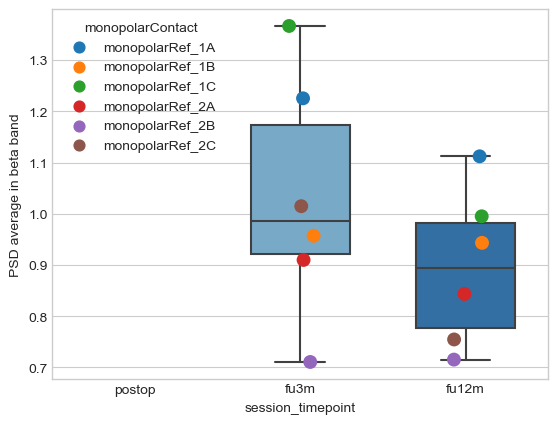

In [9]:
monopol_PSD = PSDaverageMonopol.compareMonopolarPSDaverage_freqBand(
    incl_sub=["017", "019", "024", "025", "026", "029", "030"],
    freq_band="beta"
)

## 3. Compare FOOOF monopolar estimates JLB vs. Euclidean coordinates

In [61]:
monopolar_euclidean = loadResults.load_fooof_monopolar_weighted_psd(
    fooof_spectrum = "periodic_spectrum",
    segmental = "yes",
    similarity_calculation = "inverse_distance"
)

monopolar_euclidean["fu18or24m_monopolar_Dataframe"]

,coord_z,coord_xy,session,subject_hemisphere,estimated_monopolar_beta_psd,contact,rank
1A,2.0+0.0j,0.650000+0.000000j,fu18or24m,019_Right,1.125608,1A,2.0
1B,2.0+0.0j,-0.325000+0.562917j,fu18or24m,019_Right,1.071493,1B,3.0
1C,2.0+0.0j,-0.325000-0.562917j,fu18or24m,019_Right,1.146200,1C,1.0
2A,4.0+0.0j,0.650000+0.000000j,fu18or24m,019_Right,0.865422,2A,5.0
2B,4.0+0.0j,-0.325000+0.562917j,fu18or24m,019_Right,0.786384,2B,6.0
2C,4.0+0.0j,-0.325000-0.562917j,fu18or24m,019_Right,0.871673,2C,4.0
1A,2.0+0.0j,0.650000+0.000000j,fu18or24m,019_Left,1.263689,1A,1.0
1B,2.0+0.0j,-0.325000+0.562917j,fu18or24m,019_Left,1.155039,1B,3.0
1C,2.0+0.0j,-0.325000-0.562917j,fu18or24m,019_Left,1.209461,1C,2.0
2A,4.0+0.0j,0.650000+0.000000j,fu18or24m,019_Left,0.983976,2A,4.0


## 3. Compare Johannes and Roberts method

Use automatized Function

pickle file loaded:  sub017_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
pickle file loaded:  sub017_Right_MonoRef_JLB_result_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
017_Right_fu3m
017_Right_fu12m
pickle file loaded:  sub017_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
pickle file loaded:  sub017_Left_MonoRef_JLB_result_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
017_Left_fu3m
017_Left_fu12m
pickle file loaded:  sub019_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
pickle file loaded:  sub019_Right_MonoRef_JLB_result_rawPsd_band-pass.pickle 
loaded from

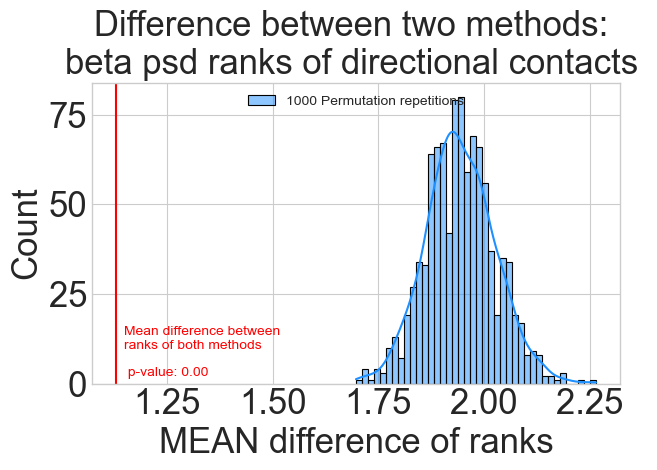

In [27]:
comparison_DF = Permute_ranks.Permutation_monopolarRanks_compareMethods(
    incl_sub= ["017", "019", "024", "025", "026", "029", "030"],
    freqBand="beta"
)

In [281]:
comparison_DF["Permutation_monopolarMethods"]


,MEAN_differenceRanks_JLB_vs_weightedByCoordinates,distanceMeanReal_MeanRandom,p-value
0,1.128788,-10.295501,0.000000000000000


Load data

In [151]:
Robert_monoRank = loadResults.load_monoRef_weightedPsdCoordinateDistance_pickle(
    sub="024",
    hemisphere="Right",
    freqBand="beta",
    normalization="rawPsd",
    filterSignal="band-pass"
)

pickle file loaded:  sub024_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-024


In [162]:
keys = list(Robert_monoRank.keys())
keys

['postop_bipolar_Dataframe',
 'postop_monopolar_Dataframe',
 'fu3m_bipolar_Dataframe',
 'fu3m_monopolar_Dataframe',
 'fu12m_bipolar_Dataframe',
 'fu12m_monopolar_Dataframe',
 'fu18m_bipolar_Dataframe',
 'fu18m_monopolar_Dataframe']

In [170]:
if "postop_monopolar_Datafram" in keys:
    print("Yes")


In [153]:
Robert_mono_postop = Robert_monoRank["postop_monopolar_Dataframe"]
Robert_mono_postop

,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank
0,0.0+0.0j,0.000000+0.000000j,024_Right,postop,0.146182,1.0
1,2.0+0.0j,0.000000+0.000000j,024_Right,postop,0.109313,2.0
2,4.0+0.0j,0.000000+0.000000j,024_Right,postop,0.052536,9.0
3,6.0+0.0j,0.000000+0.000000j,024_Right,postop,0.041568,10.0
1A,2.0+0.0j,0.650000+0.000000j,024_Right,postop,0.100037,3.0
1B,2.0+0.0j,-0.325000+0.562917j,024_Right,postop,0.099016,4.0
1C,2.0+0.0j,-0.325000-0.562917j,024_Right,postop,0.097944,5.0
2A,4.0+0.0j,0.650000+0.000000j,024_Right,postop,0.056373,6.0
2B,4.0+0.0j,-0.325000+0.562917j,024_Right,postop,0.055215,7.0
2C,4.0+0.0j,-0.325000-0.562917j,024_Right,postop,0.055096,8.0


In [171]:
Robert_mono_postop = Robert_mono_postop.loc[["1A", "1B", "1C", "2A", "2B", "2C"]]
Robert_mono_postop

,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank
1A,2.0+0.0j,0.650000+0.000000j,024_Right,postop,0.100037,3.0
1B,2.0+0.0j,-0.325000+0.562917j,024_Right,postop,0.099016,4.0
1C,2.0+0.0j,-0.325000-0.562917j,024_Right,postop,0.097944,5.0
2A,4.0+0.0j,0.650000+0.000000j,024_Right,postop,0.056373,6.0
2B,4.0+0.0j,-0.325000+0.562917j,024_Right,postop,0.055215,7.0
2C,4.0+0.0j,-0.325000-0.562917j,024_Right,postop,0.055096,8.0


In [172]:
Robert_mono_postop["directionalRank"] = Robert_mono_postop["averaged_monopolar_PSD_beta"].rank(ascending=False)
Robert_mono_directional_copy = Robert_mono_postop.copy()
Robert_mono_directional_copy

,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank,directionalRank
1A,2.0+0.0j,0.650000+0.000000j,024_Right,postop,0.100037,3.0,1.0
1B,2.0+0.0j,-0.325000+0.562917j,024_Right,postop,0.099016,4.0,2.0
1C,2.0+0.0j,-0.325000-0.562917j,024_Right,postop,0.097944,5.0,3.0
2A,4.0+0.0j,0.650000+0.000000j,024_Right,postop,0.056373,6.0,4.0
2B,4.0+0.0j,-0.325000+0.562917j,024_Right,postop,0.055215,7.0,5.0
2C,4.0+0.0j,-0.325000-0.562917j,024_Right,postop,0.055096,8.0,6.0


In [156]:
Robert_mono_directional_copy["monopolarChannels"] = np.array(["1A", "1B", "1C", "2A", "2B", "2C"])
Robert_mono_directional_copy["subject_hemisphere_monoChannel"] = Robert_mono_directional_copy[["subject_hemisphere", "monopolarChannels"]].agg("_".join, axis=1)
Robert_mono_directional_copy.drop(["subject_hemisphere", "monopolarChannels", "rank", "coord_z", "coord_xy"], axis=1, inplace=True)
Robert_mono_directional_copy

,session,averaged_monopolar_PSD_beta,directionalRank,subject_hemisphere_monoChannel
1A,postop,0.100037,1.0,024_Right_1A
1B,postop,0.099016,2.0,024_Right_1B
1C,postop,0.097944,3.0,024_Right_1C
2A,postop,0.056373,4.0,024_Right_2A
2B,postop,0.055215,5.0,024_Right_2B
2C,postop,0.055096,6.0,024_Right_2C


Load Johannes Data

In [6]:
Johannes_mono_directional = loadResults.load_monoRef_JLB_pickle(
    sub="024",
    hemisphere="Right",
    normalization="rawPsd",
    filterSignal="band-pass"
)

pickle file loaded:  sub024_Right_MonoRef_JLB_result_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-024


In [8]:
Johannes_mono_directional["monopolar_psdAverage"]

,monoRef_postop_lowBeta,monoRef_postop_highBeta,monoRef_postop_beta,monoRef_fu3m_lowBeta,monoRef_fu3m_highBeta,monoRef_fu3m_beta,monoRef_fu12m_lowBeta,monoRef_fu12m_highBeta,monoRef_fu12m_beta,monoRef_fu18m_lowBeta,monoRef_fu18m_highBeta,monoRef_fu18m_beta
monopolarRef_1A,0.245362,0.104442,0.153717,0.197695,0.224191,0.206639,0.171058,0.061935,0.100264,0.172780,0.061150,0.101359
monopolarRef_1B,0.089721,0.039062,0.056966,0.213620,0.124833,0.165468,0.126720,0.039653,0.069656,0.327036,0.062489,0.152180
monopolarRef_1C,0.122907,0.049219,0.074307,0.261357,0.236282,0.243587,0.174871,0.058034,0.098581,0.312231,0.093768,0.170699
monopolarRef_2A,0.035433,0.016107,0.022863,0.034831,0.031518,0.031846,0.035814,0.017258,0.023685,0.034325,0.014801,0.021606
monopolarRef_2B,0.012957,0.006024,0.008473,0.037637,0.017550,0.025501,0.026531,0.011049,0.016454,0.064970,0.015125,0.032439
monopolarRef_2C,0.017749,0.007590,0.011052,0.046047,0.033218,0.037540,0.036612,0.016171,0.023287,0.062029,0.022696,0.036387


In [129]:
JLB_ranks = Johannes_mono_directional["monopolar_psdRank"]

In [130]:
JLB_beta = JLB_ranks.filter(like="_beta", axis=1)
JLB_beta

,monoRef_postop_beta,monoRef_fu3m_beta,monoRef_fu12m_beta,monoRef_fu18m_beta
monopolarRef_1A,1.0,2.0,1.0,3.0
monopolarRef_1B,3.0,3.0,3.0,2.0
monopolarRef_1C,2.0,1.0,2.0,1.0
monopolarRef_2A,4.0,5.0,4.0,6.0
monopolarRef_2B,6.0,6.0,6.0,5.0
monopolarRef_2C,5.0,4.0,5.0,4.0


In [136]:
JLB_beta_copy = JLB_beta.copy()

In [147]:
# add a column with subject and hemisphere
JLB_beta_copy["subject_hemisphere"] = "024_Right"
JLB_beta_copy["monopolarChannels"] = np.array(["1A", "1B", "1C", "2A", "2B", "2C"])
JLB_beta_copy

,monoRef_postop_beta,monoRef_fu3m_beta,monoRef_fu12m_beta,monoRef_fu18m_beta,subject_hemisphere_monoChannel,subject_hemisphere,monopolarChannels
monopolarRef_1A,1.0,2.0,1.0,3.0,024_Right_1A,024_Right,1A
monopolarRef_1B,3.0,3.0,3.0,2.0,024_Right_1B,024_Right,1B
monopolarRef_1C,2.0,1.0,2.0,1.0,024_Right_1C,024_Right,1C
monopolarRef_2A,4.0,5.0,4.0,6.0,024_Right_2A,024_Right,2A
monopolarRef_2B,6.0,6.0,6.0,5.0,024_Right_2B,024_Right,2B
monopolarRef_2C,5.0,4.0,5.0,4.0,024_Right_2C,024_Right,2C


In [148]:
JLB_beta_copy["subject_hemisphere_monoChannel"] = JLB_beta_copy[["subject_hemisphere", "monopolarChannels"]].agg("_".join, axis=1)
JLB_beta_copy.drop(["subject_hemisphere", "monopolarChannels"], axis=1, inplace=True)
JLB_beta_copy

,monoRef_postop_beta,monoRef_fu3m_beta,monoRef_fu12m_beta,monoRef_fu18m_beta,subject_hemisphere_monoChannel
monopolarRef_1A,1.0,2.0,1.0,3.0,024_Right_1A
monopolarRef_1B,3.0,3.0,3.0,2.0,024_Right_1B
monopolarRef_1C,2.0,1.0,2.0,1.0,024_Right_1C
monopolarRef_2A,4.0,5.0,4.0,6.0,024_Right_2A
monopolarRef_2B,6.0,6.0,6.0,5.0,024_Right_2B
monopolarRef_2C,5.0,4.0,5.0,4.0,024_Right_2C


In [157]:
# merge postop Dataframes from Robert and JLB

compare_Robert_JLB = JLB_beta_copy.merge(Robert_mono_directional_copy, left_on="subject_hemisphere_monoChannel", right_on="subject_hemisphere_monoChannel")
compare_Robert_JLB


,monoRef_postop_beta,monoRef_fu3m_beta,monoRef_fu12m_beta,monoRef_fu18m_beta,subject_hemisphere_monoChannel,session,averaged_monopolar_PSD_beta,directionalRank
0,1.0,2.0,1.0,3.0,024_Right_1A,postop,0.100037,1.0
1,3.0,3.0,3.0,2.0,024_Right_1B,postop,0.099016,2.0
2,2.0,1.0,2.0,1.0,024_Right_1C,postop,0.097944,3.0
3,4.0,5.0,4.0,6.0,024_Right_2A,postop,0.056373,4.0
4,6.0,6.0,6.0,5.0,024_Right_2B,postop,0.055215,5.0
5,5.0,4.0,5.0,4.0,024_Right_2C,postop,0.055096,6.0


In [158]:
compare_Robert_JLB["Difference_rank_postop"] = (compare_Robert_JLB["monoRef_postop_beta"] - compare_Robert_JLB["directionalRank"]).apply(abs)
compare_Robert_JLB

,monoRef_postop_beta,monoRef_fu3m_beta,monoRef_fu12m_beta,monoRef_fu18m_beta,subject_hemisphere_monoChannel,session,averaged_monopolar_PSD_beta,directionalRank,Difference_rank_postop
0,1.0,2.0,1.0,3.0,024_Right_1A,postop,0.100037,1.0,0.0
1,3.0,3.0,3.0,2.0,024_Right_1B,postop,0.099016,2.0,1.0
2,2.0,1.0,2.0,1.0,024_Right_1C,postop,0.097944,3.0,1.0
3,4.0,5.0,4.0,6.0,024_Right_2A,postop,0.056373,4.0,0.0
4,6.0,6.0,6.0,5.0,024_Right_2B,postop,0.055215,5.0,1.0
5,5.0,4.0,5.0,4.0,024_Right_2C,postop,0.055096,6.0,1.0


In [159]:
meanDifference = compare_Robert_JLB["Difference_rank_postop"].mean()
meanDifference

0.6666666666666666

In [219]:
pd.DataFrame(comparison_DF["Permutation_monopolarMethods"])

,0
0,1.128788
1,-10.037264
2,0.000000000000000


In [28]:
DF_all = comparison_DF["Dataframe_all_sub_hem_ses"]

In [273]:
DF_all.Difference_ranks.mean()

1.128787878787879

In [203]:
pd.set_option("display.max_rows", None)
DF_all.head()

,subject_hemisphere_monoChannel,session,directionalRank,Difference_ranks
0,017_Right_1A,fu3m,4.0,3.0
1,017_Right_1B,fu3m,6.0,2.0
2,017_Right_1C,fu3m,5.0,2.0
3,017_Right_2A,fu3m,1.0,1.0
4,017_Right_2B,fu3m,3.0,3.0


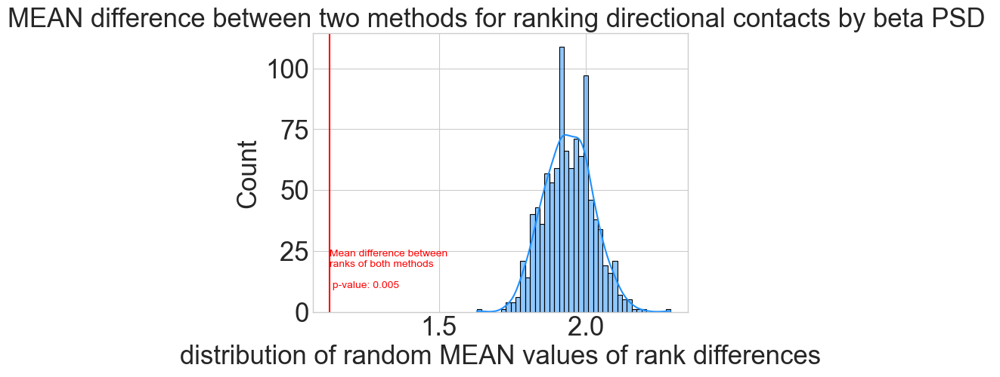

<Figure size 640x480 with 0 Axes>

In [266]:
# column to shuffle
directional_rank_x = list(DF_all.directionalRank.values)
directional_rank_y = list(DF_all.directionalRank.values)

# shuffle repetitions: 
numberOfShuffle = np.arange(1, 1001, 1)

# list of mean differences between shuffled rank_x and rank_y
difference_random_ranks = []

# repeat shuffle 1000 times
for s, shuffle in enumerate(numberOfShuffle):

    np.random.shuffle(directional_rank_x)
    np.random.shuffle(directional_rank_y)

    # calculate the mean of the difference between random rank_x and rank_y, store in list: 1000 MEAN values after all
    difference_random_ranks.append(np.mean(abs(np.array(directional_rank_x) - np.array(directional_rank_y))))


fontdict = {"size": 25} 
pval = 0.005

# plot the distribution of randomized difference MEAN values
# plt.hist(difference_random_ranks,bins=100)

# make the normal distribution fit of the data
# mu, std = norm.fit(difference_random_ranks)
# xmin, xmax = plt.xlim()
# x = np.linspace(xmin,xmax,100)
# p = norm.pdf(x, mu, std)
# axes[g].plot(x, p, 'b', linewidth= 2)

sns.histplot(difference_random_ranks, color="dodgerblue", stat="count", label="Permutation repetitions", kde=True, bins=40)

plt.title(f"MEAN difference between two methods for ranking directional contacts by beta PSD ", fontdict=fontdict)

plt.xlabel("distribution of random MEAN values of rank differences", fontsize=25, )
plt.ylabel("Count", fontsize=25)

# plt.rcParams["text.color"] = "r"

# mark with red line: real mean of the rank differences of comp_group_DF
plt.axvline(mean, c="r")
plt.text(mean, 10, "Mean difference between \nranks of both methods \n\n p-value: {:.3f}".format(pval), c="r")

#ax.set_ylim(0,25)

plt.tick_params(axis="x", labelsize=25)
plt.tick_params(axis="y", labelsize=25)

plt.show()
plt.tight_layout()

## 4. Monopolar references (Robert's method): relative to beta contact rank 1 analysis

Load data from results

In [13]:
loaded_data = loadResults.load_GroupMonoRef_weightedPsdCoordinateDistance_pickle(
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta")

pickle file loaded:  GroupMonopolar_weightedPsdCoordinateDistance_relToRank1_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [14]:
loaded_data

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank,relativePSD_to_beta_Rank1
0,0,0.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.206574,10.0,0.783786
1,1,2.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.242470,7.0,0.919984
2,2,4.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.254409,4.0,0.965286
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.263559,1.0,1.000000
4,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,6.0,0.920316
...,...,...,...,...,...,...,...,...
715,1B,2.0+0.0j,-0.325000+0.562917j,038_Left,fu3m,2.080709,2.0,0.850418
716,1C,2.0+0.0j,-0.325000-0.562917j,038_Left,fu3m,1.958221,5.0,0.800355
717,2A,4.0+0.0j,0.650000+0.000000j,038_Left,fu3m,1.292512,8.0,0.528270
718,2B,4.0+0.0j,-0.325000+0.562917j,038_Left,fu3m,1.397901,6.0,0.571344


## 5a. Externalized real monopolar recordings: WRITE dataframe

In [9]:
## find metadata excel table

patient_metadata = load_data.load_patient_metadata_externalized()

Excel file loaded:  patient_metadata.xlsx 
loaded from:  /Users/jenniferbehnke/Dropbox/work/ResearchProjects/Monopolar_power_estimation/data


In [23]:
sub_025 = load_data.load_BIDS_externalized_vhdr_files(sub="25")

Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L001/ses-LfpMedOff01/ieeg/sub-L001_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L001/ses-LfpMedOff01/ieeg/sub-L001_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L001/ses-LfpMedOff01/ieeg/sub-L001_ses-LfpMedOff01_space-MNI152NLin2009bAsym_electrodes.tsv.


Reading 0 ... 1216265  =      0.000 ...   304.066 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L001_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L001/**/ieeg/sub-L001_ses-LfpMedOff01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/Bet

In [24]:
sub_025

<RawBrainVision | sub-L001_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_ieeg.eeg, 26 x 1216266 (304.1 s), ~241.3 MB, data loaded>

In [25]:
%matplotlib widget

In [27]:
processed_LFP = externalized.preprocess_externalized_lfp(
    sub=["25", "30", "32", "47", "52", "59", 
            "61", "64", "67", "69", "71", 
            "72", "75", "77", "79", "80"])

Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L001/ses-LfpMedOff01/ieeg/sub-L001_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L001/ses-LfpMedOff01/ieeg/sub-L001_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L001/ses-LfpMedOff01/ieeg/sub-L001_ses-LfpMedOff01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1216265  =      0.000 ...   304.066 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L001_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L001/**/ieeg/sub-L001_ses-LfpMedOff01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/Bet

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL007/ses-EcogLfpMedOff01/ieeg/sub-EL007_ses-EcogLfpMedOff01_task-Rest_acq-StimOff_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL007/ses-EcogLfpMedOff01/ieeg/sub-EL007_ses-EcogLfpMedOff01_task-Rest_acq-StimOff_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL007/ses-EcogLfpMedOff01/ieeg/sub-EL007_ses-EcogLfpMedOff01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1242569  =      0.000 ...   310.642 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-EL007_ses-EcogLfpMedOff01_task-Rest_acq-StimOff_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL007/**/ieeg/sub-EL007_ses-EcogLfpMedOff01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchP

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L003/ses-LfpMedOff01/ieeg/sub-L003_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L003/ses-LfpMedOff01/ieeg/sub-L003_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L003/ses-LfpMedOff01/ieeg/sub-L003_ses-LfpMedOff01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 735459  =      0.000 ...   183.865 secs...
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L003_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L003/**/ieeg/sub-L003_ses-LfpMedOff01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/Bet

Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L007/ses-LfpMedOffDys01/ieeg/sub-L007_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L007/ses-LfpMedOffDys01/ieeg/sub-L007_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L007/ses-LfpMedOffDys01/ieeg/sub-L007_ses-LfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1526563  =      0.000 ...   381.641 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L007_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L007/**/ieeg/sub-L007_ses-LfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/Research

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL014/ses-EcogLfpMedOffDys01/ieeg/sub-EL014_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL014/ses-EcogLfpMedOffDys01/ieeg/sub-EL014_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL014/ses-EcogLfpMedOffDys01/ieeg/sub-EL014_ses-EcogLfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1767569  =      0.000 ...   441.892 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-EL014_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL014/**/ieeg/sub-EL014_ses-EcogLfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/wo

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL016/ses-EcogLfpMedOffDys01/ieeg/sub-EL016_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopaPre_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL016/ses-EcogLfpMedOffDys01/ieeg/sub-EL016_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopaPre_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL016/ses-EcogLfpMedOffDys01/ieeg/sub-EL016_ses-EcogLfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1218773  =      0.000 ...   304.693 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-EL016_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopaPre_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL016/**/ieeg/sub-EL016_ses-EcogLfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/w

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L010/ses-LfpMedOffDys01/ieeg/sub-L010_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L010/ses-LfpMedOffDys01/ieeg/sub-L010_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L010/ses-LfpMedOffDys01/ieeg/sub-L010_ses-LfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1281539  =      0.000 ...   312.876 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L010_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L010/**/ieeg/sub-L010_ses-LfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/Research

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L012/ses-LfpMedOff01/ieeg/sub-L012_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L012/ses-LfpMedOff01/ieeg/sub-L012_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L012/ses-LfpMedOff01/ieeg/sub-L012_ses-LfpMedOff01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 823483  =      0.000 ...   201.046 secs...
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L012_ses-LfpMedOff01_task-Rest_acq-StimOff_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L012/**/ieeg/sub-L012_ses-LfpMedOff01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/Bet

Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL017/ses-EcogLfpMedOffDys01/ieeg/sub-EL017_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL017/ses-EcogLfpMedOffDys01/ieeg/sub-EL017_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL017/ses-EcogLfpMedOffDys01/ieeg/sub-EL017_ses-EcogLfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 923039  =      0.000 ...   225.351 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-EL017_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL017/**/ieeg/sub-EL017_ses-EcogLfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/wo

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L013/ses-LfpMedOffDys01/ieeg/sub-L013_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L013/ses-LfpMedOffDys01/ieeg/sub-L013_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L013/ses-LfpMedOffDys01/ieeg/sub-L013_ses-LfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1483569  =      0.000 ...   370.892 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L013_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L013/**/ieeg/sub-L013_ses-LfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/Research

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L014/ses-LfpMedOff01/ieeg/sub-L014_ses-LfpMedOff01_task-Rest_acq-StimOff_run-2_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L014/ses-LfpMedOff01/ieeg/sub-L014_ses-LfpMedOff01_task-Rest_acq-StimOff_run-2_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L014/ses-LfpMedOff01/ieeg/sub-L014_ses-LfpMedOff01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1225559  =      0.000 ...   306.390 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L014_ses-LfpMedOff01_task-Rest_acq-StimOff_run-2.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L014/**/ieeg/sub-L014_ses-LfpMedOff01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM, REF_COMMONAVG, UNI_33 has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/wo

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L015/ses-LfpMedOffDys01/ieeg/sub-L015_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L015/ses-LfpMedOffDys01/ieeg/sub-L015_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L015/ses-LfpMedOffDys01/ieeg/sub-L015_ses-LfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1072847  =      0.000 ...   268.212 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L015_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L015/**/ieeg/sub-L015_ses-LfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/Research

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL019/ses-EcogLfpMedOffDys01/ieeg/sub-EL019_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL019/ses-EcogLfpMedOffDys01/ieeg/sub-EL019_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL019/ses-EcogLfpMedOffDys01/ieeg/sub-EL019_ses-EcogLfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 1601209  =      0.000 ...   390.920 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-EL019_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL019/**/ieeg/sub-EL019_ses-EcogLfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/wo

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L016/ses-LfpMedOffDys01/ieeg/sub-L016_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L016/ses-LfpMedOffDys01/ieeg/sub-L016_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L016/ses-LfpMedOffDys01/ieeg/sub-L016_ses-LfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 798187  =      0.000 ...   199.547 secs...
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L016_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L016/**/ieeg/sub-L016_ses-LfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/Research

Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L017/ses-LfpMedOffDys01/ieeg/sub-L017_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L017/ses-LfpMedOffDys01/ieeg/sub-L017_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L017/ses-LfpMedOffDys01/ieeg/sub-L017_ses-LfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 971539  =      0.000 ...   242.885 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-L017_ses-LfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-L017/**/ieeg/sub-L017_ses-LfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/Research

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Extracting parameters from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL021/ses-EcogLfpMedOffDys01/ieeg/sub-EL021_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_ieeg.vhdr...
Setting channel info structure...
Reading channel info from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL021/ses-EcogLfpMedOffDys01/ieeg/sub-EL021_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1_channels.tsv.
Reading electrode coords from /Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL021/ses-EcogLfpMedOffDys01/ieeg/sub-EL021_ses-EcogLfpMedOffDys01_space-MNI152NLin2009bAsym_electrodes.tsv.
Reading 0 ... 892184  =      0.000 ...   223.046 secs...


/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: Did not find any events.tsv associated with sub-EL021_ses-EcogLfpMedOffDys01_task-Rest_acq-StimOffDopa00_run-1.

The search_str was "/Users/jenniferbehnke/OneDrive - Charité - Universitätsmedizin Berlin/BIDS_01_Berlin_Neurophys/rawdata/sub-EL021/**/ieeg/sub-EL021_ses-EcogLfpMedOffDys01*events.tsv"
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/work/ResearchProjects/BetaSenSightLongterm/code/BetaSenSightLongterm/src/bssu/utils/load_data_files.py:178: RuntimeWarning: The unit for channel(s) ACC_L_X_D2_TM, ACC_L_Y_D2_TM, ACC_L_Z_D2_TM, ACC_R_X_D2_TM, ACC_R_Y_D2_TM, ACC_R_Z_D2_TM has changed from V to NA.
  data = mne_bids.read_raw_bids(bids_path=bids_path) # datatype: mne.io.brainvision.brainvision.RawBrainVision
/Users/jenniferbehnke/Dropbox/wo

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
externalized_preprocessed_data.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/Monopolar_power_estimation/results
externalized_recording_info_original.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/Monopolar_power_estimation/results
mne_objects_cropped_2_min.pickle 
written in: /Users/jenniferbehnke/Dropbox/work/ResearchProjects/Monopolar_power_estimation/results


In [41]:
group_data = processed_LFP["group_data"]
sub_025_1A = group_data.original_lfp.values[1]
sub_025_time = group_data.original_time_stamps[1]


In [31]:
sub025_original_2min = processed_LFP["mne_objects"]["25_original_2min"]
sub025_resampled_2min = processed_LFP["mne_objects"]["25_resampled_2min"]

Effective window size : 8.192 (s)


/var/folders/8d/3m_ljz890_j62q7hb7mpzdc40000gn/T/ipykernel_76820/1471638237.py:1: RuntimeWarning: in version 1.5, the default behavior of Spectrum.plot() will change so that bad channels will be shown by default. To keep the old default behavior (and silence this warning), explicitly pass `picks='data', exclude='bads'`.
  sub025_resampled_2min.compute_psd(method="welch").plot()
/var/folders/8d/3m_ljz890_j62q7hb7mpzdc40000gn/T/ipykernel_76820/1471638237.py:1: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  sub025_resampled_2min.compute_psd(method="welch").plot()


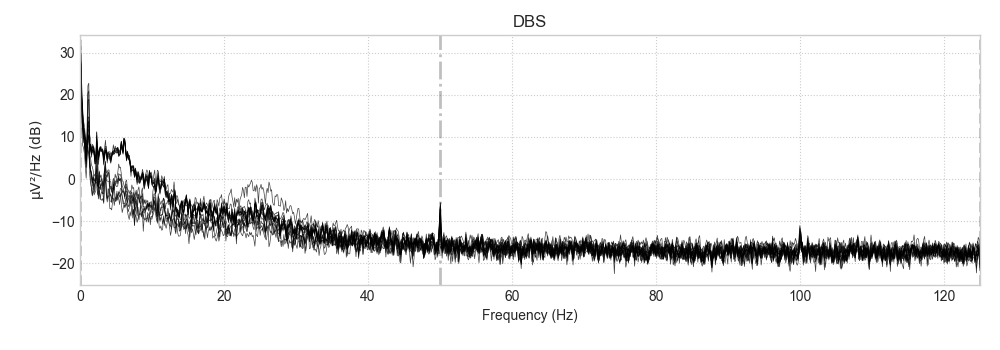

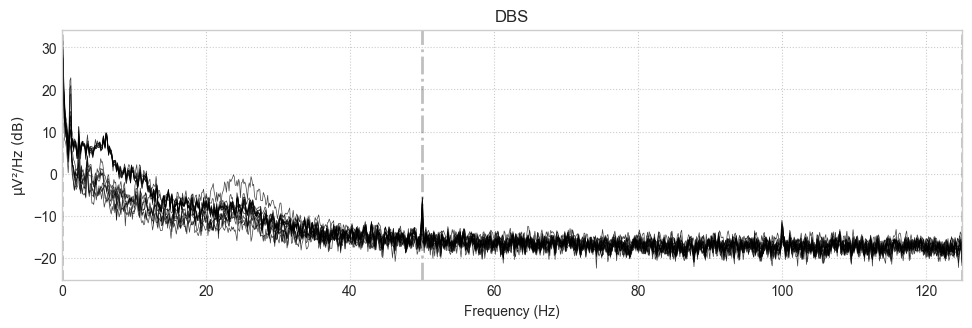

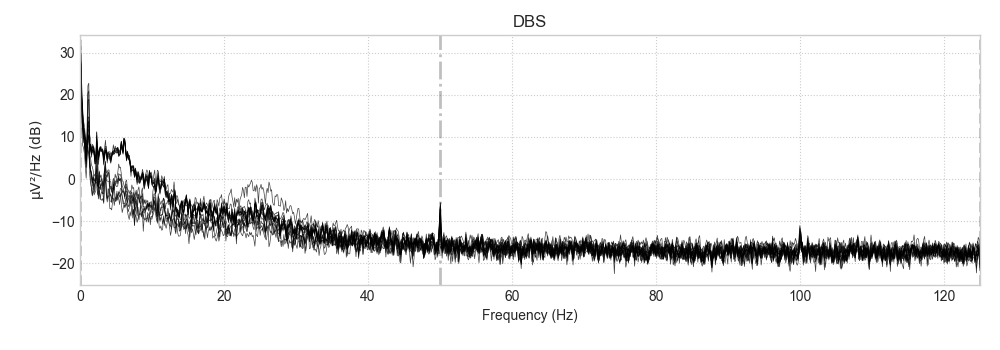

In [38]:
sub025_resampled_2min.compute_psd(method="welch").plot()


In [46]:
band_pass_filtered = data.filter(l_freq=5.0, h_freq=95.0)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 5 - 95 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 5.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Upper passband edge: 95.00 Hz
- Upper transition bandwidth: 23.75 Hz (-6 dB cutoff frequency: 106.88 Hz)
- Filter length: 6601 samples (1.650 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  18 out of  18 | elapsed:    0.3s finished


In [99]:
# band pass and notch filter
filter_params = mne.filter.create_filter(
    data.get_data(), data.info["sfreq"], l_freq=5.0, h_freq=95.0
)

Setting up band-pass filter from 5 - 95 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 5.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 4.00 Hz)
- Upper passband edge: 95.00 Hz
- Upper transition bandwidth: 23.75 Hz (-6 dB cutoff frequency: 106.88 Hz)
- Filter length: 6601 samples (1.650 s)



Setting up band-pass filter from 5 - 95 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 20 (effective, after forward-backward)
- Cutoffs at 5.00, 95.00 Hz: -6.02, -6.02 dB



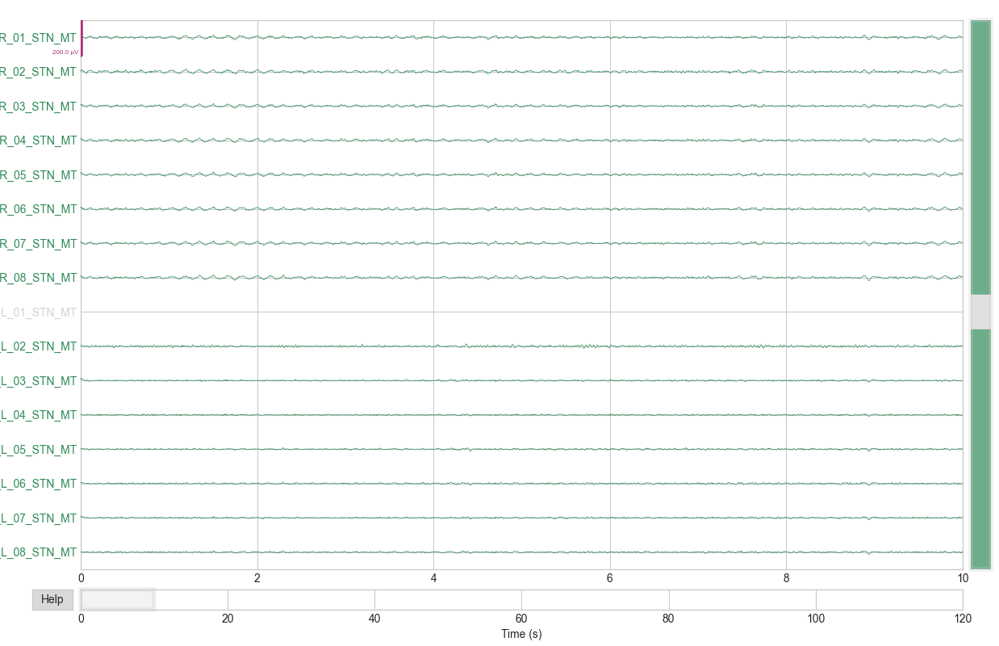

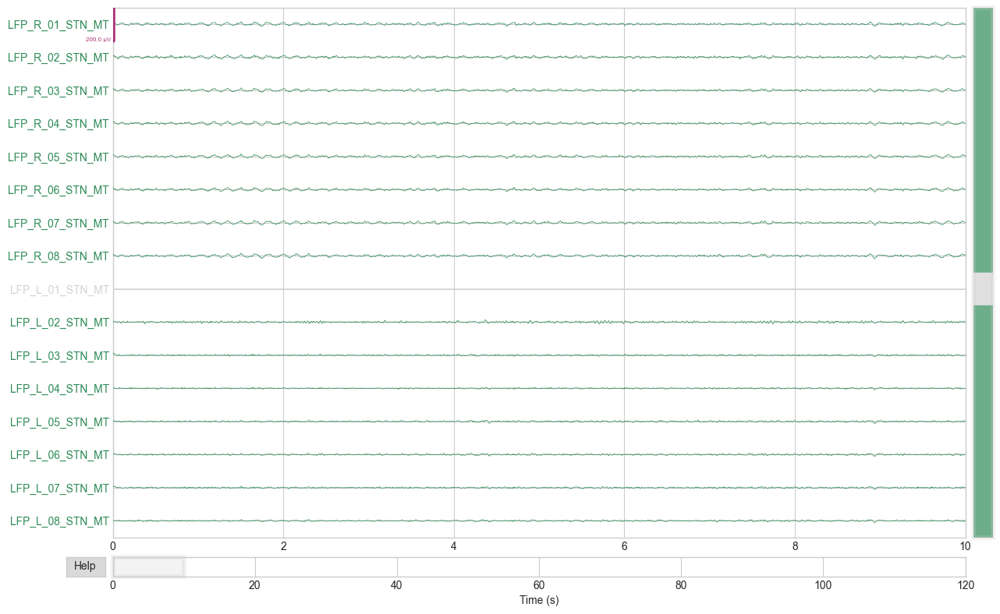

In [116]:
data.plot(highpass=5.0, lowpass=95.0, filtorder=5.0)

In [117]:
# downsample to Percept sfreq
resampled = data.copy().resample(sfreq=250.0)

Effective window size : 8.192 (s)


/var/folders/8d/3m_ljz890_j62q7hb7mpzdc40000gn/T/ipykernel_69319/348041205.py:1: RuntimeWarning: in version 1.5, the default behavior of Spectrum.plot() will change so that bad channels will be shown by default. To keep the old default behavior (and silence this warning), explicitly pass `picks='data', exclude='bads'`.
  resampled.compute_psd(tmax=np.inf, fmax=125).plot(average=True, exclude="bads")


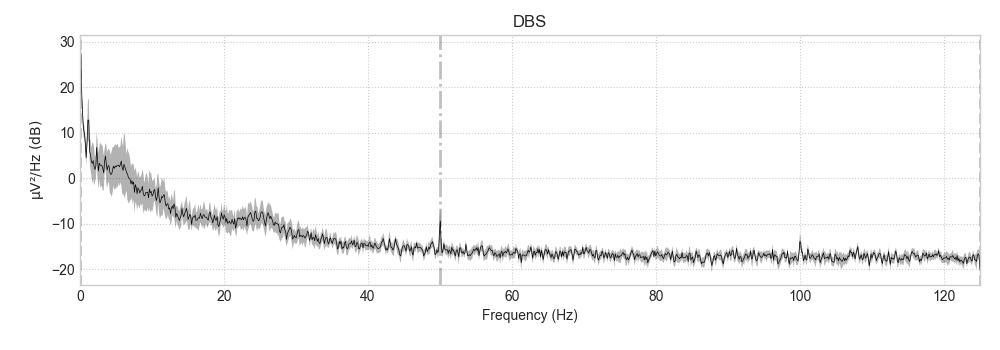

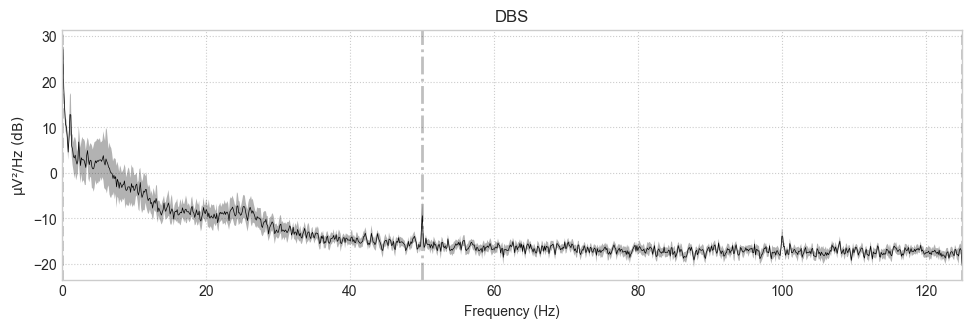

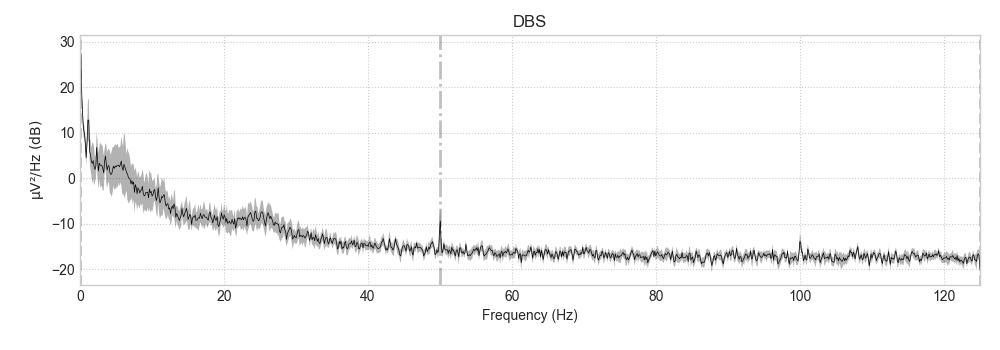

In [118]:
resampled.compute_psd(tmax=np.inf, fmax=125).plot(average=True, exclude="bads")

Effective window size : 0.512 (s)


/var/folders/8d/3m_ljz890_j62q7hb7mpzdc40000gn/T/ipykernel_69319/4021619259.py:1: RuntimeWarning: in version 1.5, the default behavior of Spectrum.plot() will change so that bad channels will be shown by default. To keep the old default behavior (and silence this warning), explicitly pass `picks='data', exclude='bads'`.
  fig = data.compute_psd(tmax=np.inf, fmax=100).plot(average=True, exclude="bads")


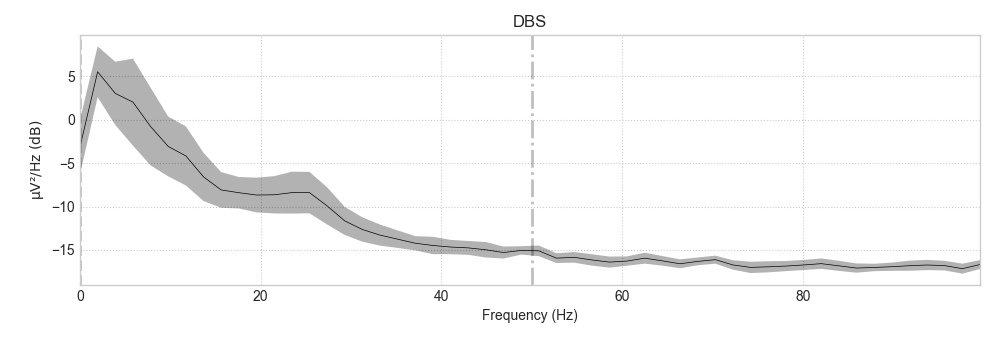

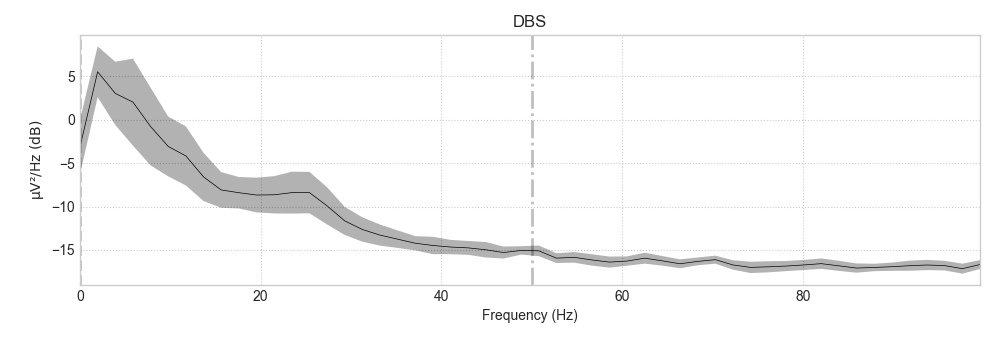

In [120]:
fig = data.compute_psd(tmax=np.inf, fmax=100).plot(average=True, exclude="bads")

In [57]:
# get index of each channel and get the corresponding LFP data
R_ch_identifier = ["LFP_R_01", "LFP_R_02", "LFP_R_03", "LFP_R_04", "LFP_R_05", "LFP_R_06", "LFP_R_07", "LFP_R_08"]
L_ch_identifier = ["LFP_L_01", "LFP_L_02", "LFP_L_03", "LFP_L_04", "LFP_L_05", "LFP_L_06", "LFP_L_07", "LFP_L_08"]


channel_index = [index for index, name in enumerate(ch_names) if "LFP_R_01" in name]

# plot filtered channels 1-8 [0]-[7] Right and 9-16 [8]-[15] 
# butterworth filter: band pass -> filter order = 5, high pass 5 Hz, low-pass 95 Hz
# nodge filter: 48-52 Hz

channel_lfp = lfp_data[channel_index[0]]



# detect artefacts 
# remove artefacts (cut out)

## 5b. Externalized recordings: Load and plot 